# SCRIPT FOR ANALYSIS OF CELLS ANALYZED WITH ISS

This script shows how to analyze a typical ISS segmented dataset. The analysis is based on Scanpy (documentation in  https://scanpy.readthedocs.io/en/stable/index.html) and Squidpy (documentation in https://squidpy.readthedocs.io/en/stable/)

## Loading the packages

We import the packages needed for it. If something fails, means that we haven't installed something in the environment

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

# Load the functions

In [24]:
def map_of_clusters(adata,key='leiden',clusters='all',size=8,background='white',figuresize=(10,7),save=None,format='pdf'):
    
    #PARAMETERS TO MODIFY:
    #-key: the terms in adata.obs that you want to plot
    #-clusters:'all' for plotting all clusters in a single plot, 'individual': for plots of individual genes, or ['3','5'] (your groups
    #          between square brackets to plot only some clusters
    #-size: to change the size of your spots
    #-background: to change the color of the background
    #-figuresize: to specify the size of your figure
    #-save: if you want to save your figure, give the PATH of the folder where you want to save it
    #-format: specify the format in which you want to save your figure
    
    try:
        adata.obs[key]=adata.obs[key].astype(int)
        colors=dict(zip(np.unique(adata.obs[key]),adata.uns[key+'_colors']))
    except:
        colors=dict(zip(np.unique(adata.obs[key]),adata.uns[key+'_colors']))
    #cl.apply(lambda x: colors[x])
    plt.rcParams['figure.facecolor'] = background
    if clusters=='all':
        cl=adata.obs[key]
        plt.figure(figsize=figuresize)
        figa=plt.scatter(x=adata.obs.X,y=adata.obs.Y,c=cl.apply(lambda x: colors[x]),s=size,linewidths=0, edgecolors=None)
        plt.axis('off')
        if not save==None:
            plt.savefig(save +'/map_all_clusters_'+str(size)+'_'+background+'_'+key+'.'+format)
    elif clusters=='individual':
        cl=adata.obs[key]
        for each in adata.obs[key].unique():
            adatasub=adata[adata.obs[key]==each]
            plt.figure(figsize=figuresize)
            plt.scatter(x=adata.obs.X,y=adata.obs.Y,c='grey',s=size/5,linewidths=0, edgecolors=None)
            cl=adatasub.obs[key]
            plt.scatter(x=adatasub.obs.X,y=adatasub.obs.Y,c=cl.apply(lambda x: colors[x]),s=size,linewidths=0, edgecolors=None)
            plt.axis('off')
            plt.title('Group: '+ str(each))
            if not save==None:
                plt.savefig(save +'/map_inidivdual_cluster_'+str(each)+'_'+str(size)+background+'_'+key+'.'+format)
    else:
        adatasub=adata[adata.obs[key].isin(clusters)]
        plt.figure(figsize=figuresize)
        plt.scatter(x=adata.obs.X,y=adata.obs.Y,c='grey',s=size/5,linewidths=0, edgecolors=None)
        cl=adatasub.obs[key]
        plt.scatter(x=adatasub.obs.X,y=adatasub.obs.Y,c=cl.apply(lambda x: colors[x]),s=size,linewidths=0, edgecolors=None)
        plt.axis('off')
        plt.legend()
        if not save==None:
                s=''
                for element in clusters:
                    s=s+str(element)
                print(s)
                plt.savefig(save +'/map_group_of_clusters_'+str(s)+'_'+str(size)+background+'_'+key+'.'+format)
#        plt.title('Group: '+ paste(clusters))

## Importing the data and creating an anndata object

If we visualize what's on the data we see that we have the expression of the analyzed genes on every cell (row) together with the XY position of the cells and other metadata.  

In [3]:
adata1=sc.read(r"C:\Users\sergio.salas\Documents\PhD\projects\Xenium_postprocessing\formated_adata\ms_brain_rep1.h5ad")
adata2=sc.read(r"C:\Users\sergio.salas\Documents\PhD\projects\Xenium_postprocessing\formated_adata\ms_brain_rep2.h5ad")
adata3=sc.read(r"C:\Users\sergio.salas\Documents\PhD\projects\Xenium_postprocessing\formated_adata\ms_brain_rep3.h5ad")

transcript_id
281496451547136     True
281496451547137    False
281496451547138    False
281496451547139     True
281496451547140     True
                   ...  
281513631826456     True
281513631826457     True
281513631826458    False
281513631826459     True
281513631826460     True
Name: overlaps_nucleus, Length: 8161013, dtype: bool

In [43]:
def nuclear_object(adata1):
    subset1=adata1.uns['spots'].loc[adata1.uns['spots']['overlaps_nucleus']==1,:]
    ct1=pd.crosstab(subset1['cell_id'],subset1['feature_name'])
    adataobs=adata1.obs.loc[adata1.obs['cell_id'].isin(ct1.index),:]
    ct1=ct1.loc[:,adata1.var.index]
    adataobs.index=adataobs['cell_id']
    adataobs.index.name='ind'
    adata1nuc=sc.AnnData(np.array(ct1),obs=adataobs,var=adata1.var)
    return adata1nuc

In [46]:
adata1new=nuclear_object(adata1)
adata2new=nuclear_object(adata2)
adata3new=nuclear_object(adata3)

C:\Users\sergio.salas\Miniconda3\lib\site-packages\anndata\_core\anndata.py:119: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\sergio.salas\Miniconda3\lib\site-packages\anndata\_core\anndata.py:119: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\sergio.salas\Miniconda3\lib\site-packages\anndata\_core\anndata.py:119: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [48]:
adata1=adata1new[:,adata1new.var['in_panel']]
adata2=adata2new[:,adata2new.var['in_panel']]
adata3=adata3new[:,adata3new.var['in_panel']]

In [49]:
adata1.obs['replicate']='1'
adata2.obs['replicate']='2'
adata3.obs['replicate']='3'

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


In [50]:
adata=sc.concat([adata1,adata2,adata3])

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


The object where our data is contained is called anndata (documentation in https://anndata.readthedocs.io/en/latest/). The expression is stored in adata.X. The metadata is stored in adata.obs. The data associated with the genes is stored in adata.var

In [51]:
adata.obs

,cell_id,x_centroid,y_centroid,transcript_counts,control_probe_counts,control_codeword_counts,total_counts,cell_area,nucleus_area,graph_clusters,kmeans2_clusters,kmeans3_clusters,kmeans4_clusters,kmeans5_clusters,kmeans6_clusters,kmeans7_clusters,kmeans8_clusters,kmeans9_clusters,kmeans10_clusters,replicate
ind,,,,,,,,,,,,,,,,,,,,
1,1,821.466797,605.680298,94,0,0,94,148.789844,32.647969,1,1,1,1,1,1,1,1,1,1,1
2,2,823.761719,615.448608,60,0,0,60,118.715781,32.738281,12,1,1,1,1,1,1,1,1,1,1
3,3,828.706482,625.965942,38,0,0,38,35.176719,23.661875,1,1,1,1,1,1,1,1,1,1,1
4,4,817.234131,627.839111,162,0,0,162,236.663906,71.211406,14,1,1,1,1,1,1,1,1,1,1
5,5,829.293518,632.736938,67,0,0,67,71.798438,48.317188,15,1,1,1,1,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28642,28642,2563.504883,3637.863770,146,0,0,146,184.960000,22.442656,19,2,2,2,2,2,2,2,2,2,3
28643,28643,2549.242188,3632.845459,265,0,0,265,207.267188,23.300625,6,2,2,2,2,2,2,2,2,2,3
28644,28644,2536.471191,3638.641113,412,0,0,412,499.202344,48.136562,6,2,2,2,2,2,2,2,2,2,3


 We calculate the total number of reads in each cell and store it in 'total_counts'.We keep cells with more than X reads and less than Y reads

In [52]:
maximum_numbers_of_reads=1500
minimum_number_of_reads=10

In [53]:
adata.obs=adata.obs.reset_index()

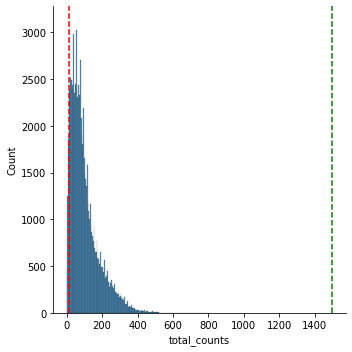

In [54]:
adata.obs['total_counts']=list(np.sum(adata.X,axis=1))
sns.displot(adata.obs,x='total_counts')
plt.axvline(x=maximum_numbers_of_reads,color='green',linestyle='--')
plt.axvline(x=minimum_number_of_reads,color='red',linestyle='--')
adata=adata[adata.obs['total_counts']>minimum_number_of_reads] #adjust the numbers to keep good cells according to appropiate ones
adata=adata[adata.obs['total_counts']<maximum_numbers_of_reads] #adjust the numbers to more than

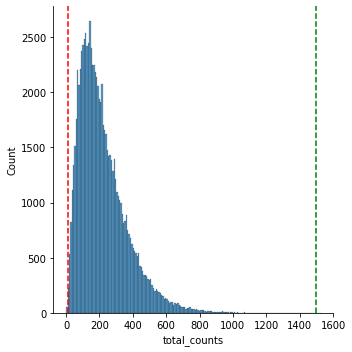

In [10]:
adata.obs['total_counts']=list(np.sum(adata.X,axis=1))
sns.displot(adata.obs,x='total_counts')
plt.axvline(x=maximum_numbers_of_reads,color='green',linestyle='--')
plt.axvline(x=minimum_number_of_reads,color='red',linestyle='--')
adata=adata[adata.obs['total_counts']>minimum_number_of_reads] #adjust the numbers to keep good cells according to appropiate ones
adata=adata[adata.obs['total_counts']<maximum_numbers_of_reads] #adjust the numbers to more than

# Normalization of the data

We now save the raw data in adata.raw and apply normalization and log-transformation to minimize the effect of outliers. We also scale the data to give the same importance to all genes in clustering

In [55]:
adata.raw=adata
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

C:\Users\sergio.salas\Miniconda3\lib\site-packages\anndata\_core\anndata.py:119: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


[OPTIONAL] After normalizing and logmarizing, the data we CAN, if we wish, filter only highly variable genes for clustering. This step is key in the analysis of single cell RNA sequencing datasets (with +20.000 genes) but it's not that useful in targeted methods such as ISS. However, it can help to keep variables only for clustering

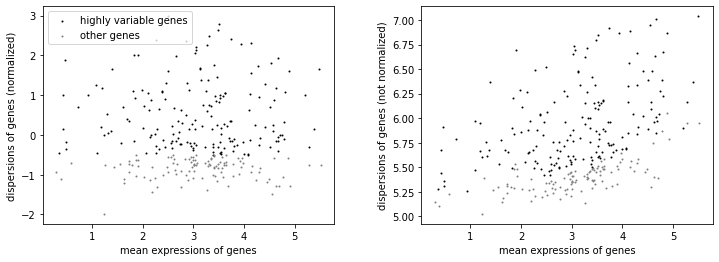

In [56]:
plt.rcParams['figure.facecolor'] = 'white'
sc.pp.highly_variable_genes(adata, min_mean=0.3, max_mean=7, min_disp=-0.5)
sc.pl.highly_variable_genes(adata)
#adata=adata[:,adata.var.highly_variable==True]

[OPTIONAL] We can also scale the data. This means that we scale the expression of every gene between 0 and 1. This will give decrease the impact of highly expressed genes and will increase the importance of lowly expressed genes

In [57]:
#let's not scale in this case
#sc.pp.scale(adata,max_value=100)

# Dimensional reduction and clustering

We apply principal component analysis to find the appropiate nubmer of components to use to perform dimensionality reduction and clustering

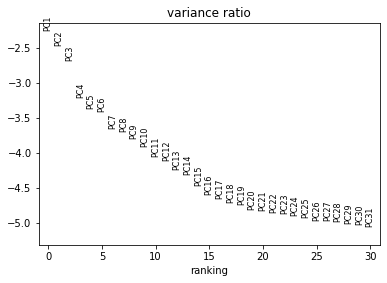

In [58]:
sc.tl.pca(adata, svd_solver='arpack')
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.pca_variance_ratio(adata, log=True)

We select to go with the top X first principal components to look for the nearest neighbors. We are going to represent our data using graph-based methods, like UMAP. For this, we first need to create a graph by linking each cell to the n closest neighbors (n_neighbors) in the dataset. We can select the numbers of principal components to use

In [59]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=40)

We can, then, run clustering, by calling either leiden or louvain clustering. By changing the parameter "resolution" we will generate more or less clusters. Higher resolution means more clusters. The clusters (groups of cells) are indepent from its visualization, which we will create using UMAP later on

In [60]:
sc.tl.leiden(adata,resolution=2.2,key_added='leiden_2_2')
sc.tl.leiden(adata,resolution=1.8,key_added='leiden_1_8')
sc.tl.leiden(adata,resolution=1.4,key_added='leiden_1_4')
sc.tl.leiden(adata,resolution=1.0,key_added='leiden_1_0')
sc.tl.leiden(adata,resolution=0.8,key_added='leiden_0_8')
sc.tl.leiden(adata,resolution=0.6,key_added='leiden_0_6')

To VISUALIZE the diversity of our cells, We perfrom UMAP. The closest two spots are in UMAP, the more similar they will be. With the comand sc.tl.umap. we CALCULATE the UMAP embedding. With sc.pl.umap will VISUALIZE the UMAP.

In [61]:
sc.tl.umap(adata,min_dist=0.1)

On top of the UMAP you can visualize any variable that you might be interested (a metadata column or gene expression). We need to modify the parameter "color" to visualize the appropiate variable on the UMAP

In [62]:
sc.set_figure_params(scanpy=True, dpi=150)
plt.rcParams['figure.facecolor'] = 'white'

In [63]:
adata.obs['leiden_2_2']=adata.obs['leiden_2_2'].astype(str)

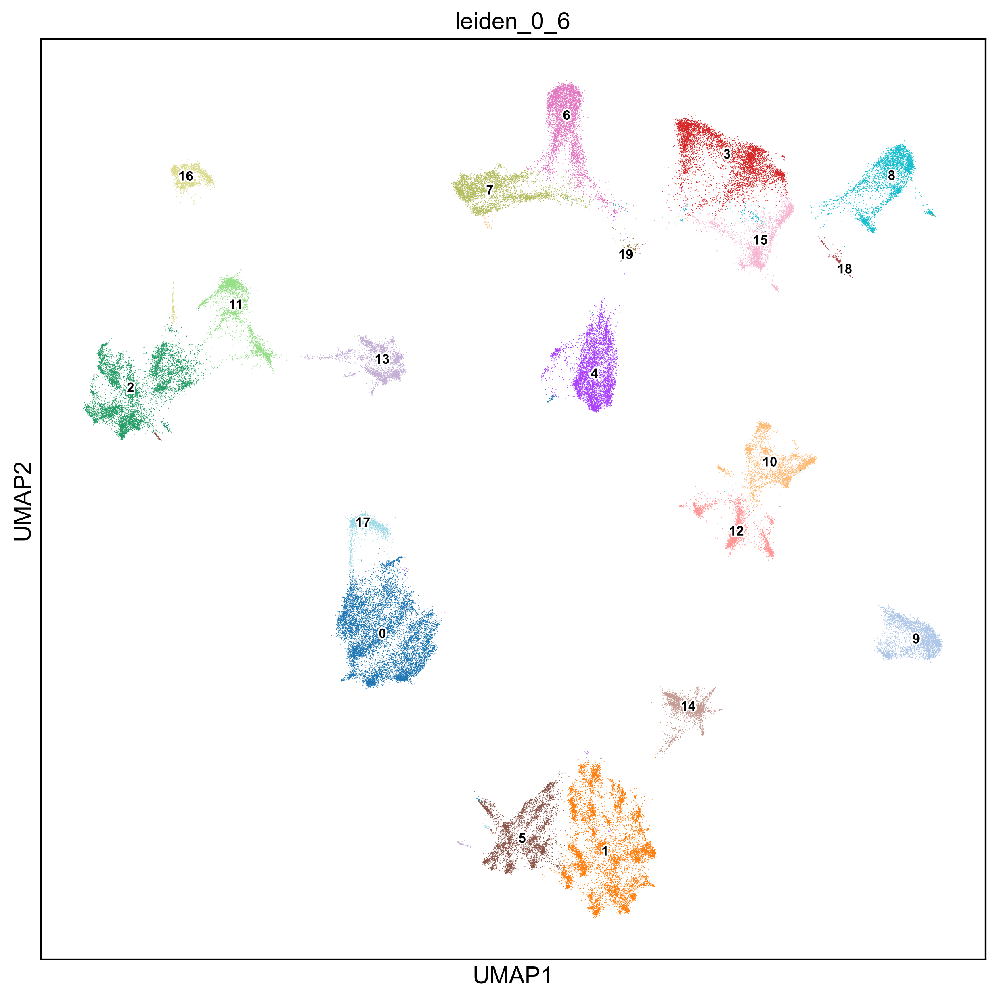

In [81]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,color=['leiden_0_6'],size=1,legend_loc='on data',legend_fontsize=8,legend_fontoutline=2)#,save='umap_3replicates_1_4_ondata_updated_nuclear_reads.pdf')

... storing 'ind' as categorical
... storing 'graph_clusters' as categorical
... storing 'replicate' as categorical
... storing 'leiden_2_2' as categorical


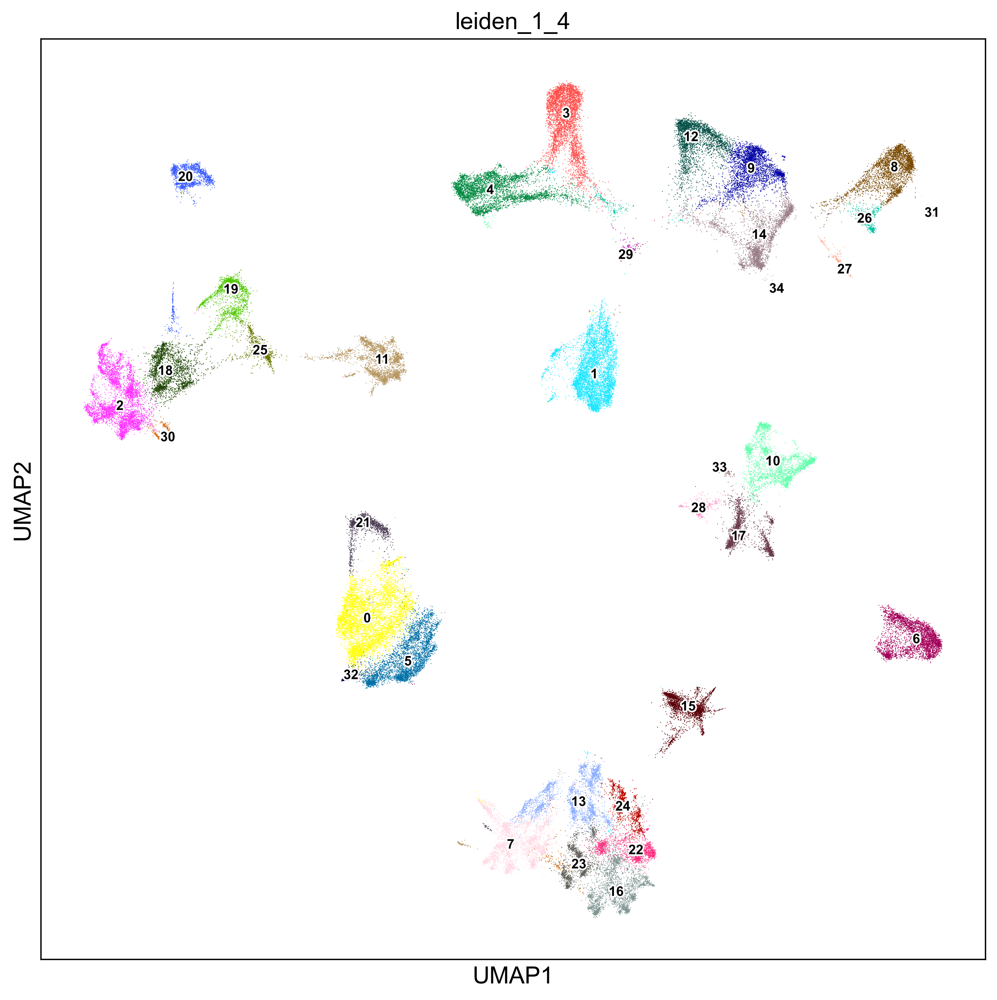

In [64]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,color=['leiden_1_4'],size=1,legend_loc='on data',legend_fontsize=8,legend_fontoutline=2,save='umap_3replicates_1_4_ondata_updated_nuclear_reads.pdf')

In [65]:
saving_path=r'C:\Users\sergio.salas\Documents\PhD\projects\Xenium_postprocessing\formated_adata'
adata.write(saving_path+'/adata_3replicates_updated_nuclear_only.h5ad')

In [67]:
adata.obs['cell_code']=list(adata.obs['cell_id'].astype(str)+'_'+adata.obs['replicate'].astype(str))

In [66]:
adata_exp=sc.read(saving_path+'/adata_3replicates_updated_with_annotations.h5ad')

In [74]:
transdict=dict(zip(adata_exp.obs['cell_code'],adata_exp.obs['Class']))
transdict_anno=dict(zip(adata_exp.obs['cell_code'],adata_exp.obs['initial_annotation']))

In [73]:
adata.obs['expanded_class']=list(adata.obs['cell_code'].map(transdict))

In [75]:
adata.obs['expanded_initial_annotation']=list(adata.obs['cell_code'].map(transdict_anno))

... storing 'expanded_class' as categorical
... storing 'expanded_initial_annotation' as categorical


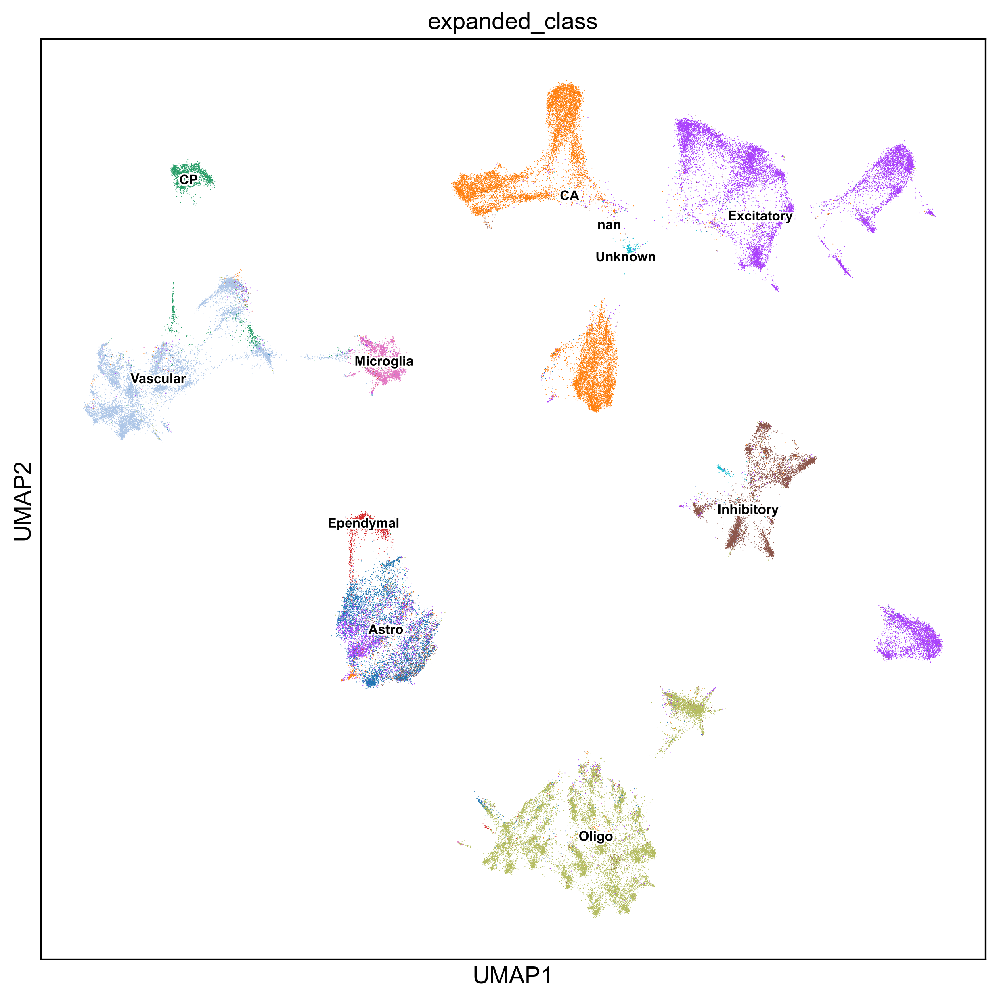

In [76]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,color=['expanded_class'],size=1,legend_loc='on data',legend_fontsize=8,legend_fontoutline=2,save='umap_3replicates_expanded_class_ondata_updated_nuclear_reads.pdf')

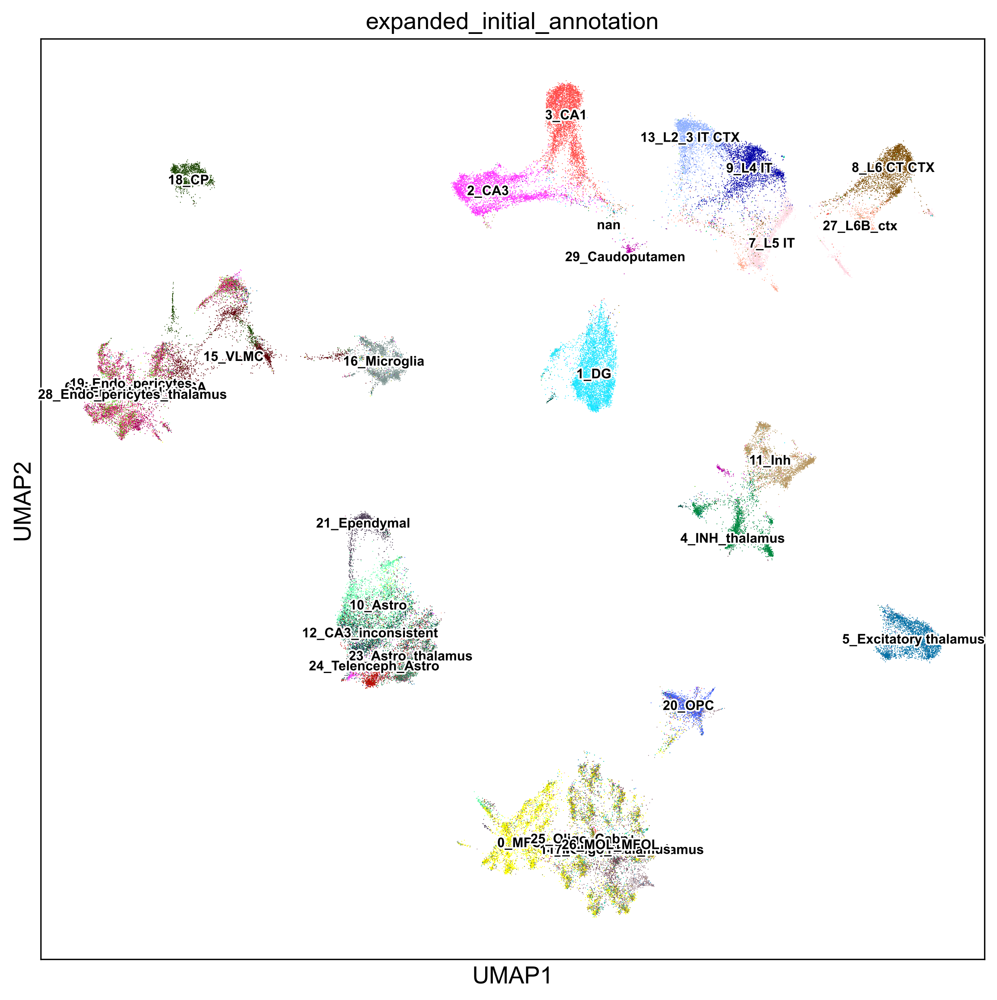

In [77]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,color=['expanded_initial_annotation'],size=1,legend_loc='on data',legend_fontsize=8,legend_fontoutline=2,save='umap_3replicates_expanded_initial_annotation_ondata_updated_nuclear_reads.pdf')

In [3]:
saving_path=r'C:\Users\sergio.salas\Documents\PhD\projects\Xenium_postprocessing\formated_adata'
adata=sc.read(saving_path+'/adata_3replicates_updated.h5ad')

In [7]:
adata

AnnData object with n_obs × n_vars = 85037 × 284
    obs: 'index', 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'graph_clusters', 'kmeans2_clusters', 'kmeans3_clusters', 'kmeans4_clusters', 'kmeans5_clusters', 'kmeans6_clusters', 'kmeans7_clusters', 'kmeans8_clusters', 'kmeans9_clusters', 'kmeans10_clusters', 'replicate', 'leiden_2_2', 'leiden_1_8', 'leiden_1_4', 'leiden_1_0', 'leiden_0_8', 'leiden_0_6'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_1_4_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

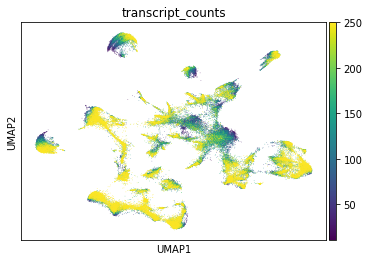

In [11]:
sc.pl.umap(adata,color=['transcript_counts'],cmap='viridis',vmax=250)

# Plotting clusters on the tissue

We now go back to the tissue and plot the clusters back. For this we use the function 'map_of_clusters' to plot clusters on the tissue

In [78]:
adata.obs['X']=adata.obs['x_centroid']
adata.obs['Y']=adata.obs['y_centroid']

Trying to set attribute `.obs` of view, copying.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


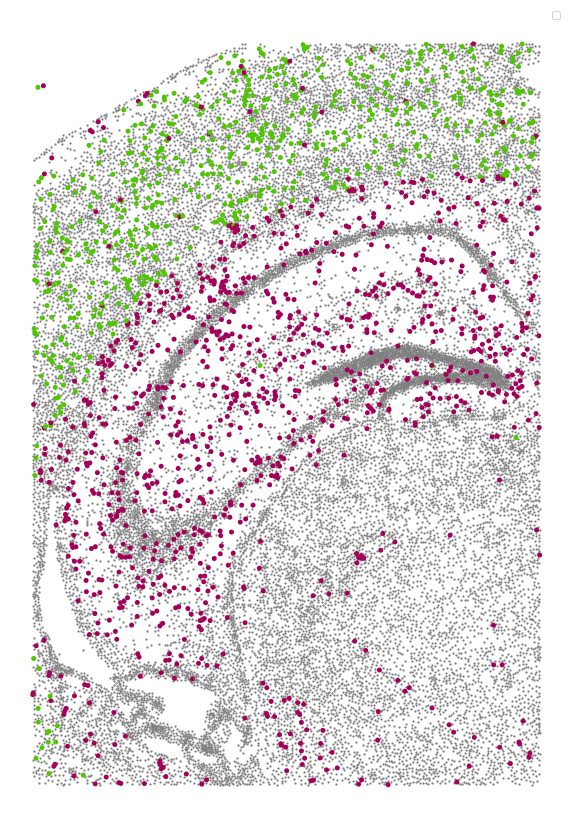

In [28]:
adatasub=adata[adata.obs['replicate']=='1']
map_of_clusters(adatasub,key='leiden_1_4',size=25,background='white',clusters=['6','19'],figuresize=(10,15))#,save='C:/Users/sergio.salas/Documents/PhD/JNotebooks/Xenium/figures',format='jpg')

Trying to set attribute `.obs` of view, copying.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


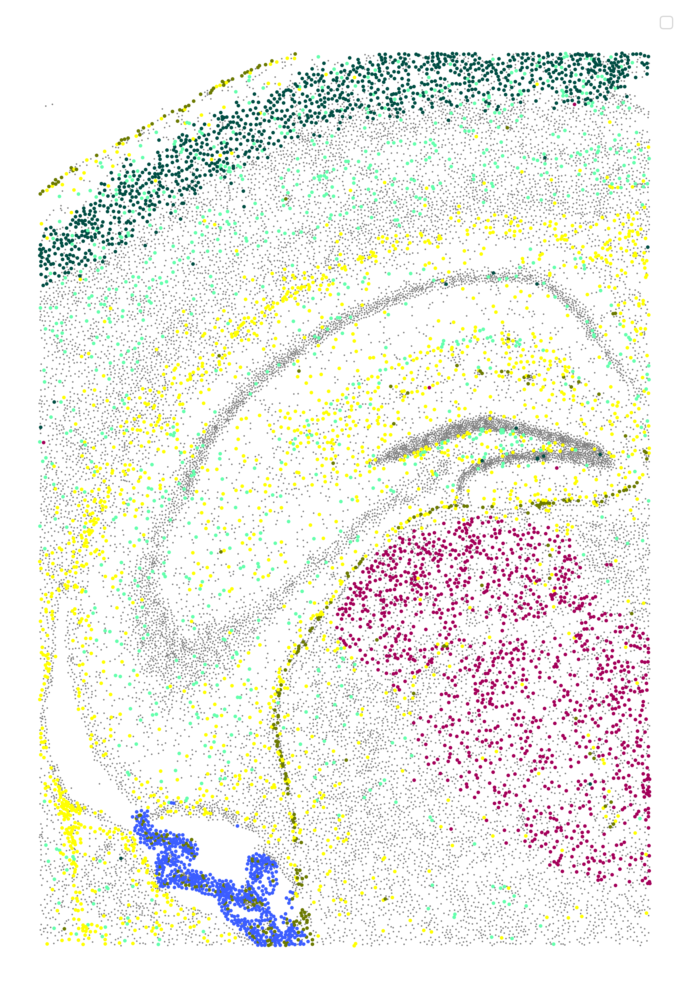

In [79]:
adatasub=adata[adata.obs['replicate']=='1']
map_of_clusters(adatasub,key='leiden_1_4',size=9,background='white',clusters=['6','0','10','12','25','20'],figuresize=(10,15))#,save='C:/Users/sergio.salas/Documents/PhD/JNotebooks/Xenium/figures',format='jpg')

Trying to set attribute `.obs` of view, copying.
<ipython-input-2-a835ff74dc52>:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=figuresize)


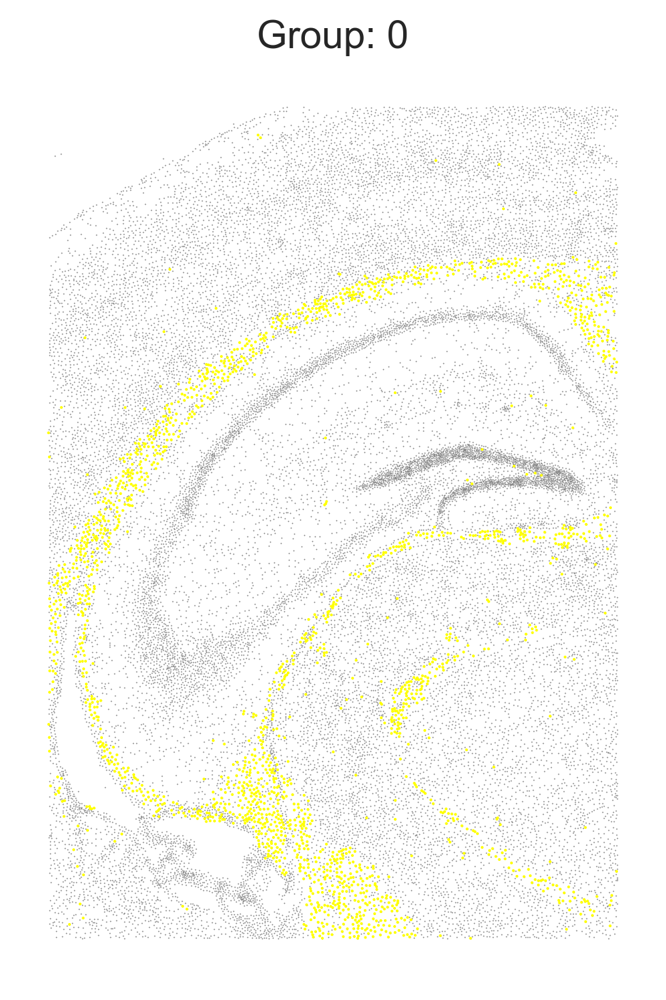

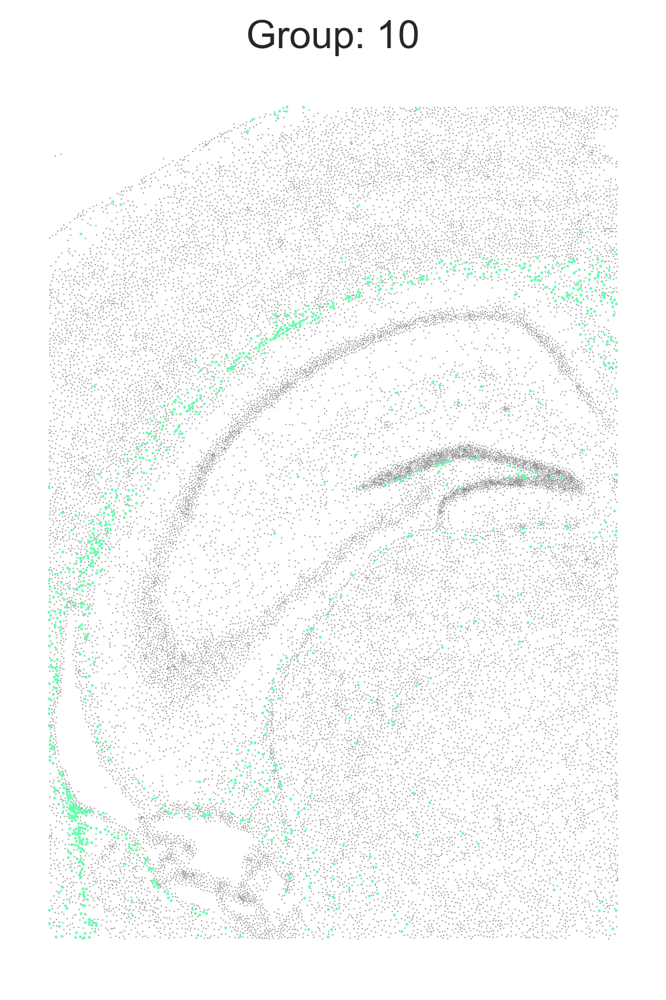

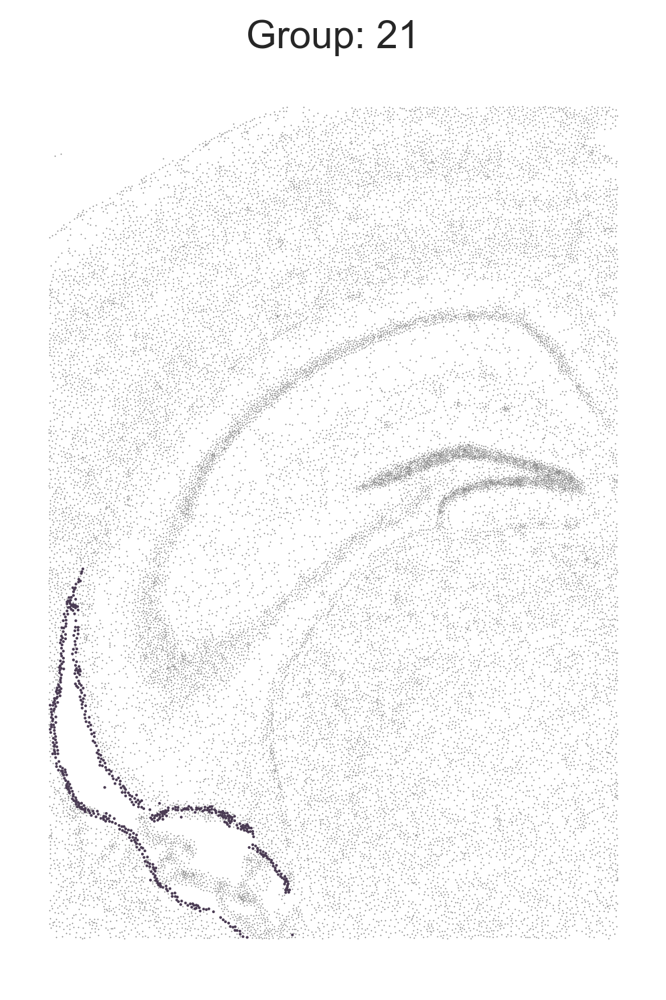

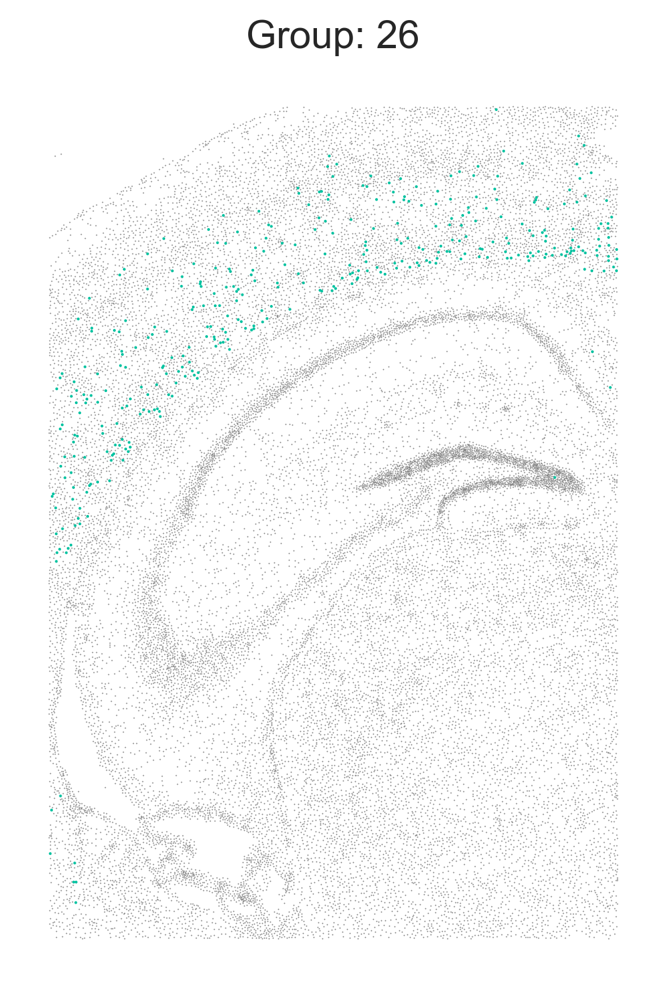

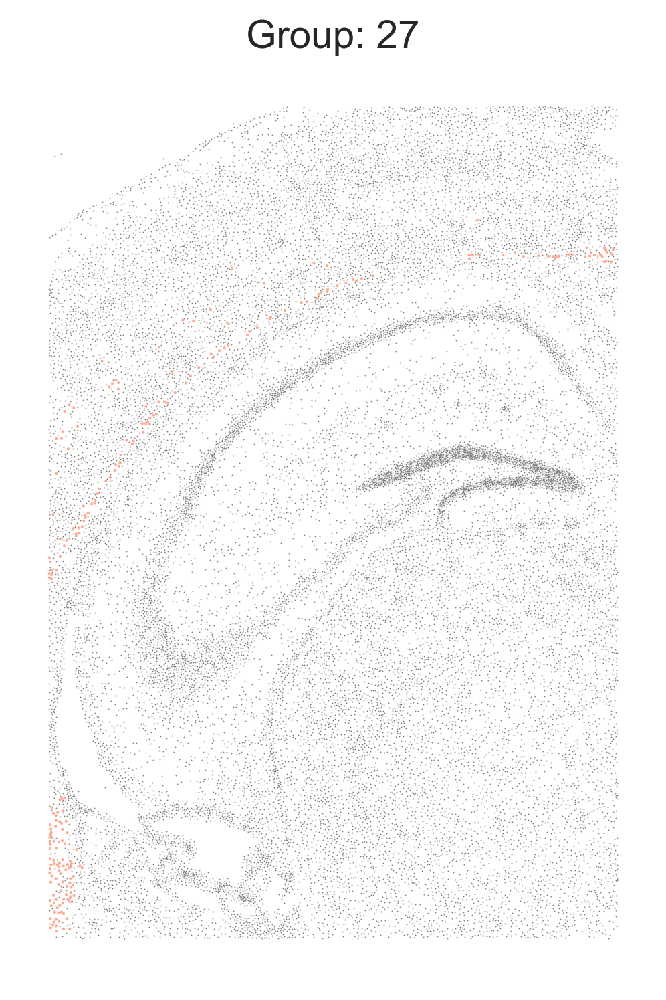

...

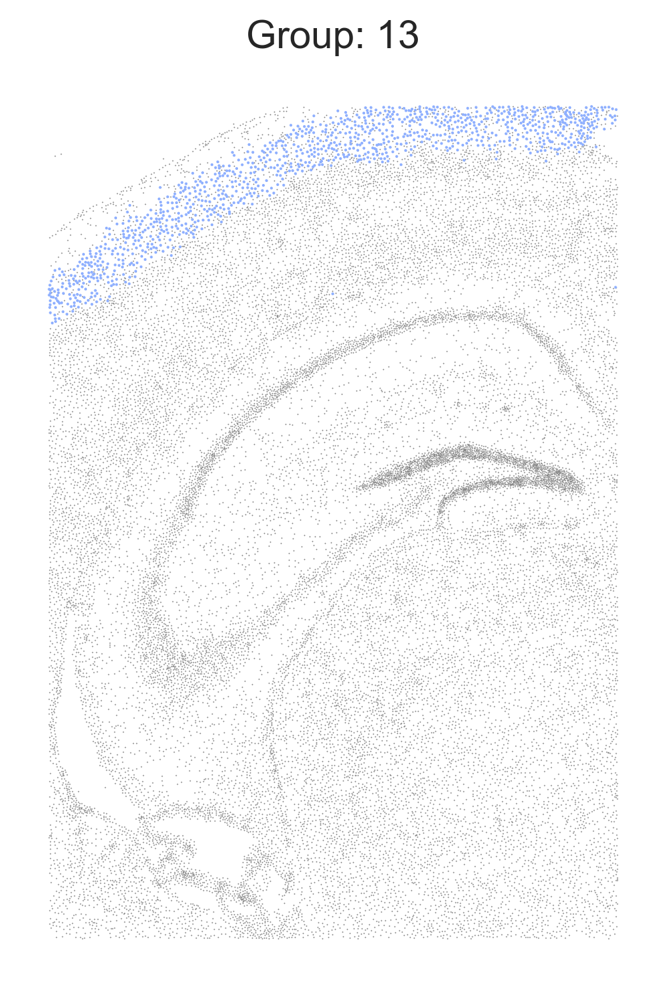

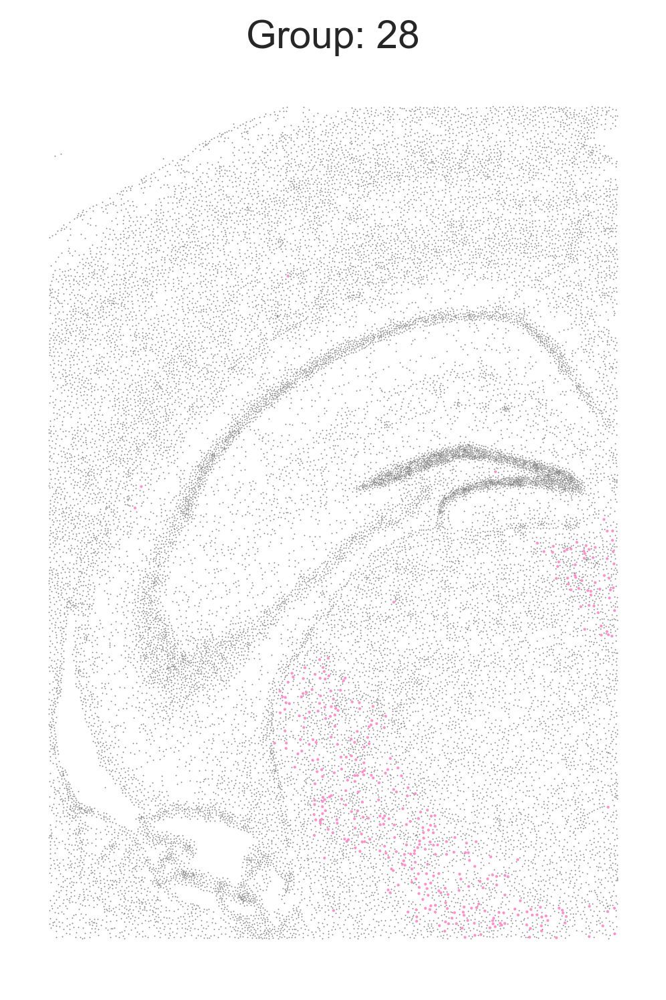

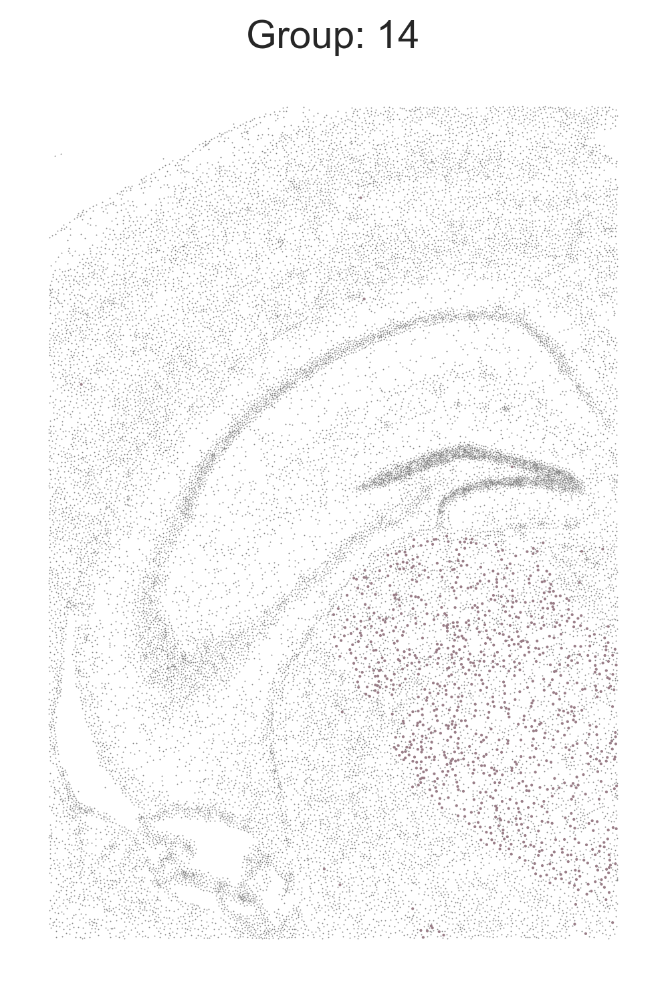

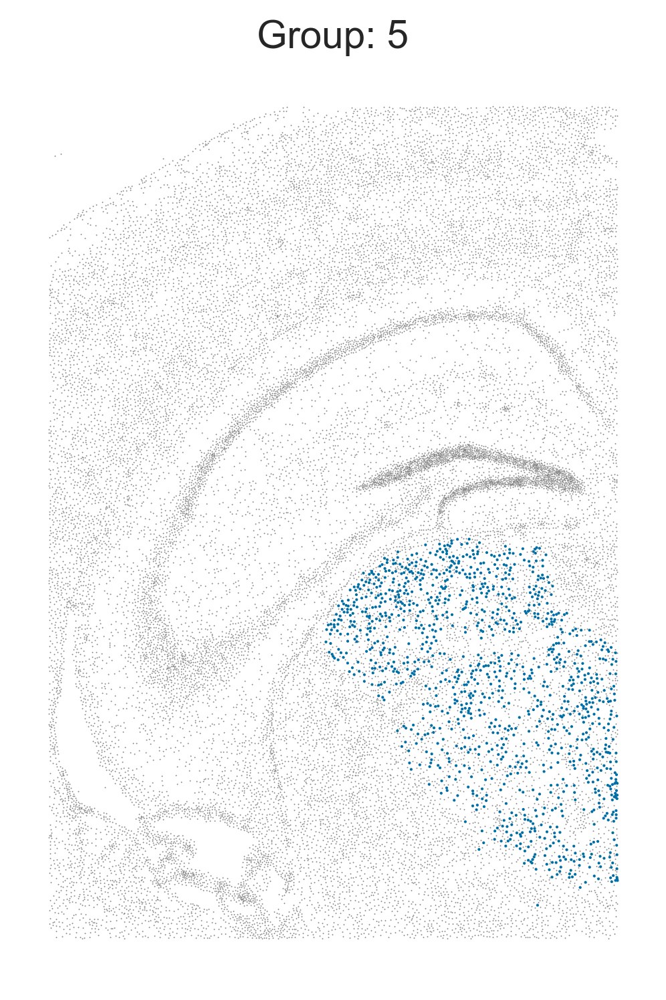

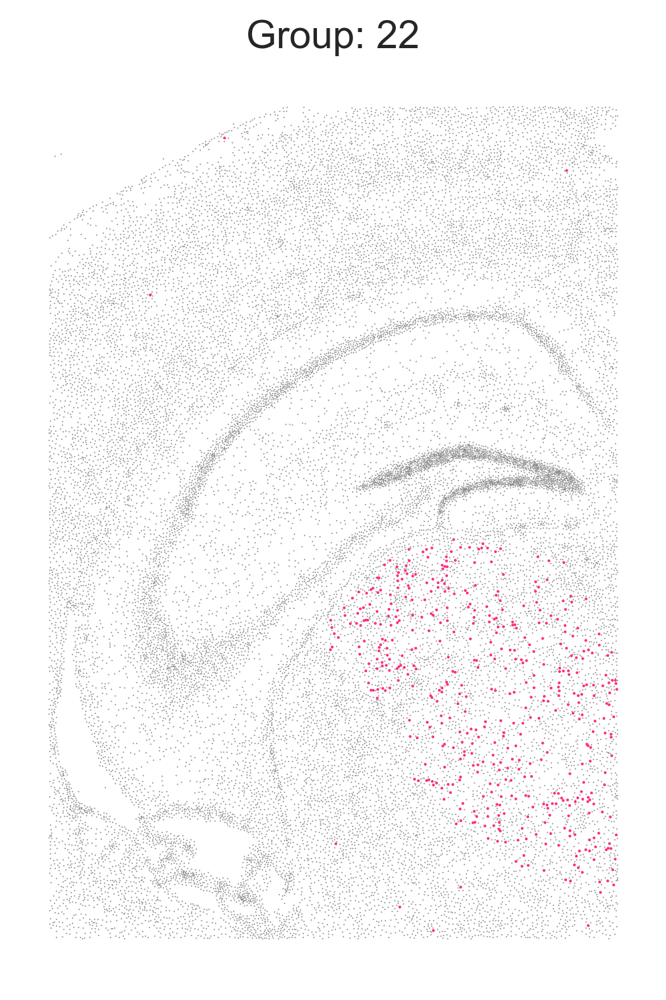

In [102]:
adatasub=adata[adata.obs['replicate']=='1']
map_of_clusters(adatasub,key='leiden_1_4',size=1,background='white',clusters='individual',figuresize=(4,6))#,save='C:/Users/sergio.salas/Documents/PhD/JNotebooks/Xenium/figures',format='jpg')

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


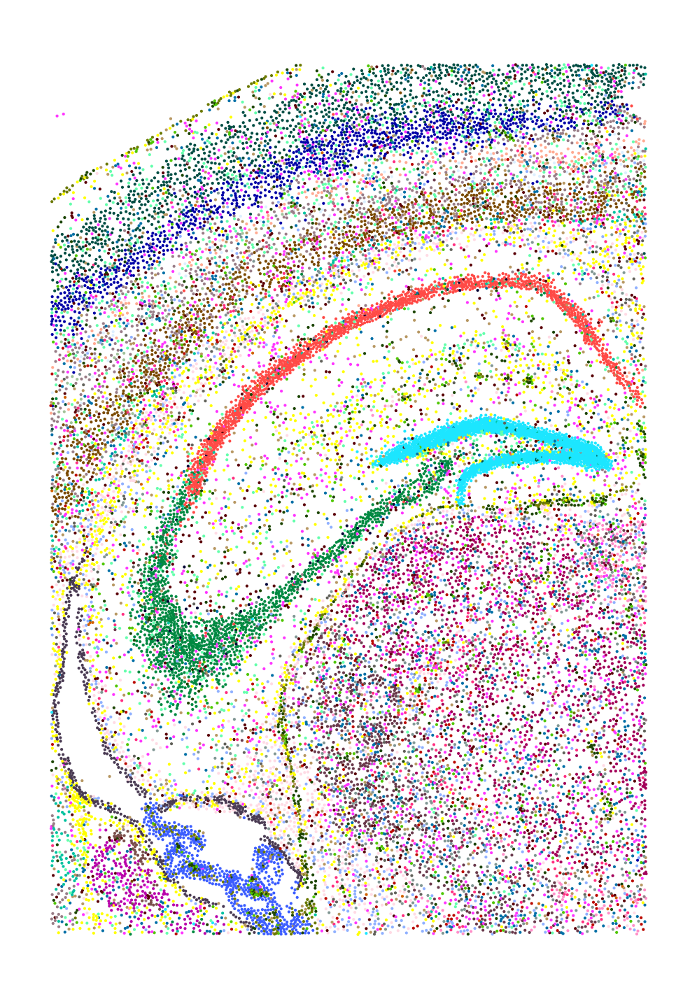

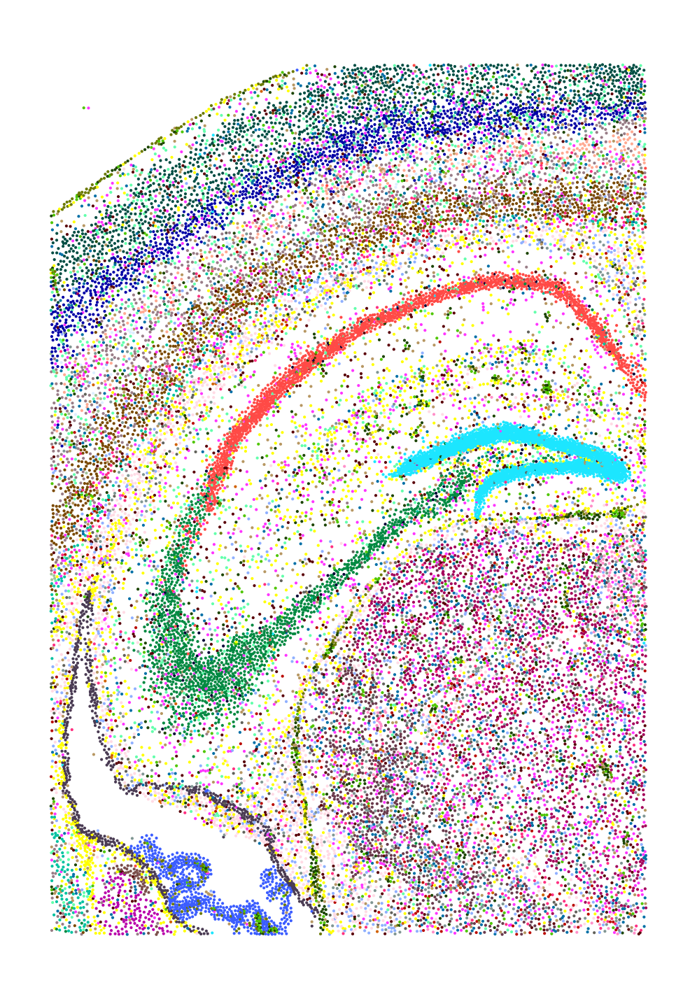

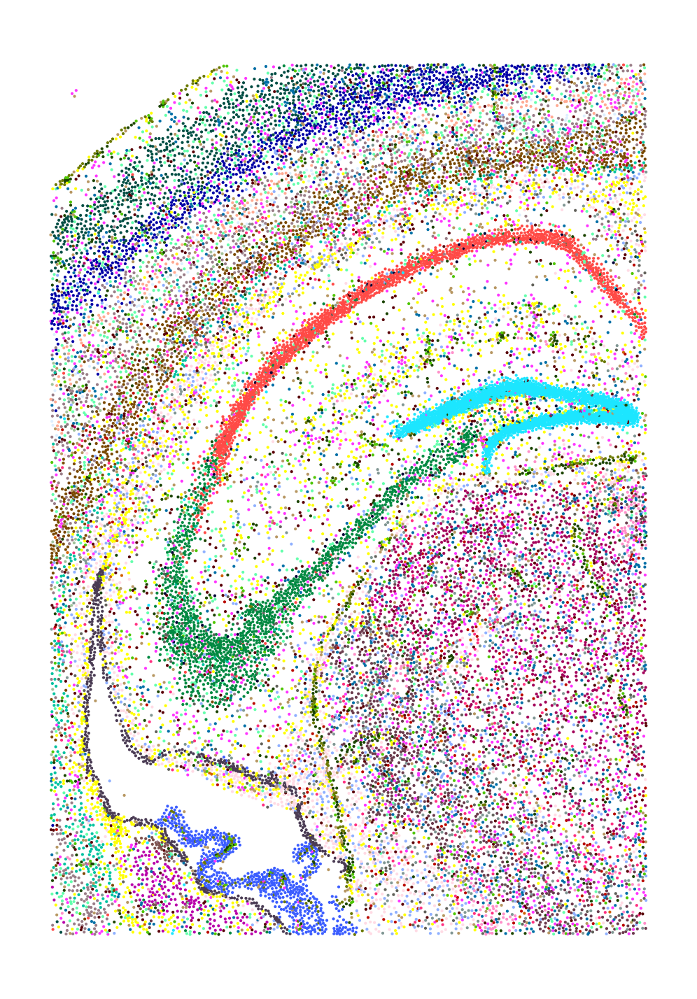

In [80]:
for s in adata.obs['replicate'].unique():
    adatasub=adata[adata.obs['replicate']==s]
    map_of_clusters(adatasub,key='leiden_1_4',size=1,background='white',clusters='all',figuresize=(4,6))#,save='C:/Users/sergio.salas/Documents/PhD/JNotebooks/Xenium/figures',format='jpg')

In [23]:
crs=pd.crosstab(adata.obs['leiden_1_4'],adata.obs['replicate'])

In [24]:
crs_perc=crs.div(crs.sum(axis=0),axis=1)*100

In [25]:
plt.style.available[0]

'Solarize_Light2'

In [29]:
path=r'C:\Users\sergio.salas\Documents\PhD\projects\Xenium_postprocessing\figures'

seaborn-white


C:\Users\sergio.salas\Miniconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


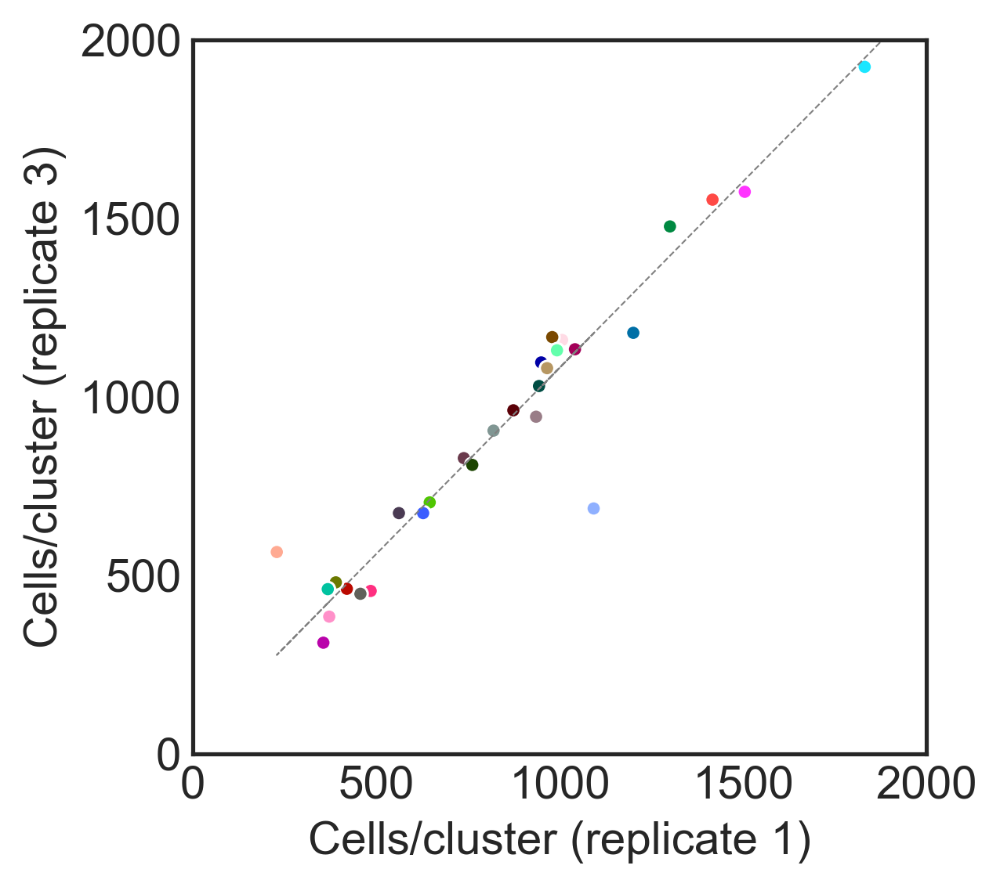

In [30]:
print('seaborn-white')
plt.style.use('seaborn-white')
m, b = np.polyfit(crs.iloc[:,0],crs.iloc[:,2], 1)
plt.figure(figsize=(4,4))
#add linear regression line to scatterplot 
plt.plot(crs.iloc[:,0], m*crs.iloc[:,0]+b,c='gray',linestyle='dashed',linewidth=0.5)
sns.scatterplot(crs.iloc[:,0],crs.iloc[:,2],s=80,c=adata.uns['leiden_1_4_colors'],marker='.')
plt.xlabel('Cells/cluster (replicate 1)')
plt.ylabel('Cells/cluster (replicate 3)')
plt.xlim([0,2000])
plt.ylim([0,2000])
plt.savefig(path+r'\scatter_frequencies_13_upd.pdf')

seaborn-white


C:\Users\sergio.salas\Miniconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


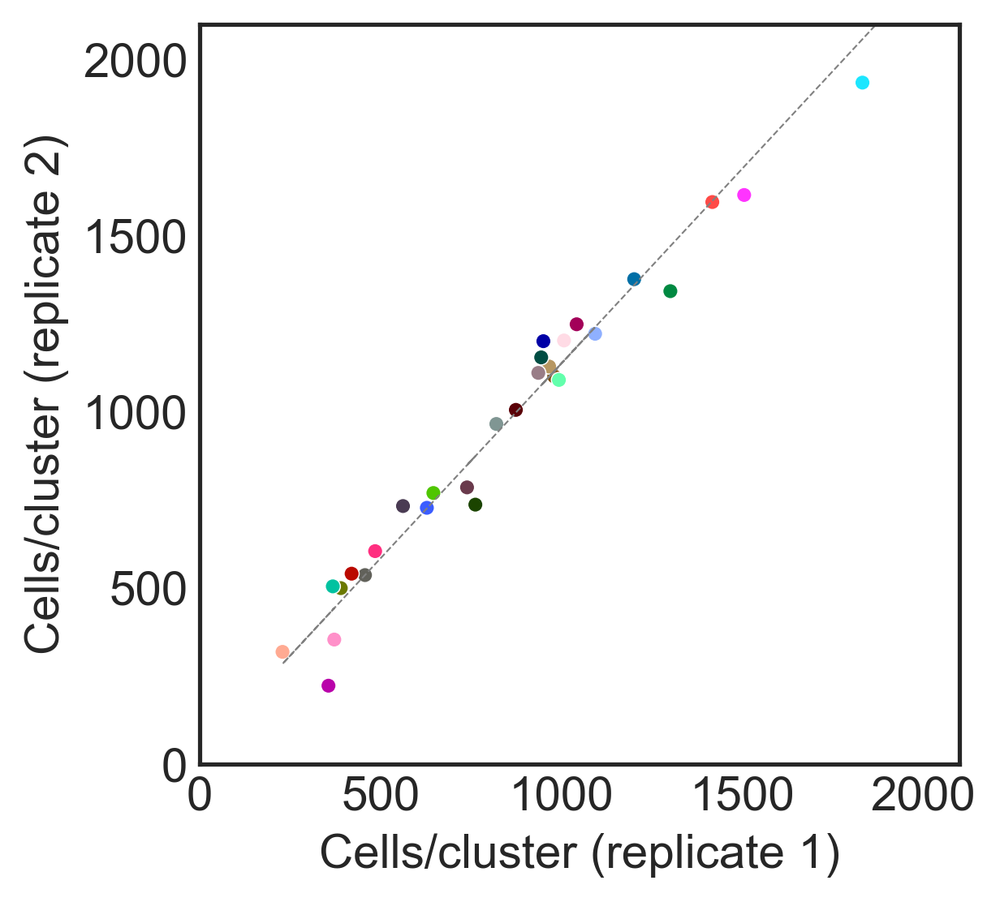

In [31]:
print('seaborn-white')
plt.style.use('seaborn-white')
m, b = np.polyfit(crs.iloc[:,0],crs.iloc[:,1], 1)
plt.figure(figsize=(4,4))
plt.plot(crs.iloc[:,0], m*crs.iloc[:,0]+b,c='gray',linestyle='dashed',linewidth=0.5)
sns.scatterplot(crs.iloc[:,0],crs.iloc[:,1],s=20,c=adata.uns['leiden_1_4_colors'])
plt.xlabel('Cells/cluster (replicate 1)')
plt.ylabel('Cells/cluster (replicate 2)')
plt.xlim([0,2100])
plt.ylim([0,2100])
plt.savefig(path+r'\scatter_frequencies_12.pdf')

In [124]:
# These are the correlation values between the three replicates

In [32]:
np.corrcoef(crs.iloc[:,2],crs.iloc[:,0])

array([[1.        , 0.96670361],
       [0.96670361, 1.        ]])

In [33]:
np.corrcoef(crs.iloc[:,1],crs.iloc[:,2])

array([[1.        , 0.96486203],
       [0.96486203, 1.        ]])

In [34]:
np.corrcoef(crs.iloc[:,1],crs.iloc[:,0])

array([[1.        , 0.98743847],
       [0.98743847, 1.        ]])

In [36]:
adata.obs['X_umap']=list(pd.DataFrame(adata.obsm['X_umap'])[0])
adata.obs['Y_umap']=list(pd.DataFrame(-adata.obsm['X_umap'])[1])

In [37]:
adata.obs['Y_umap']

0       -2.282273
1       -3.222615
2       -2.300976
3       -2.169016
4       -8.490835
           ...   
85104    2.556425
85105    5.065410
85106    5.017804
85107    5.429061
85108    5.633955
Name: Y_umap, Length: 85037, dtype: float64

In [88]:
adata.obs['X']=adata.obs['x_centroid']*4.70588
adata.obs['Y']=adata.obs['y_centroid']*4.70588

In [39]:
adata_obs=adata.obs

In [40]:
adata_obs['UMAP']=list(adata_obs['X_umap'].astype(str)+';'+adata_obs['Y_umap'].astype(str))

In [107]:
exp=pd.DataFrame(adata.raw.X,columns=adata.var.index,index=adata.obs.index)

In [47]:
sc.tl.rank_genes_groups(adata, 'leiden_1_4', method='wilcoxon', key_added = "wilcoxon")


In [63]:

sc.pl.rank_genes_groups(adata, n_genes=5, sharey=False, key="wilcoxon",fontsize=25,save='original_leiden_3repl_1_4_deg_update.pdf')

In [13]:
adata

AnnData object with n_obs × n_vars = 85037 × 284
    obs: 'index', 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'graph_clusters', 'kmeans2_clusters', 'kmeans3_clusters', 'kmeans4_clusters', 'kmeans5_clusters', 'kmeans6_clusters', 'kmeans7_clusters', 'kmeans8_clusters', 'kmeans9_clusters', 'kmeans10_clusters', 'replicate', 'leiden_2_2', 'leiden_1_8', 'leiden_1_4', 'leiden_1_0', 'leiden_0_8', 'leiden_0_6'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_1_4_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

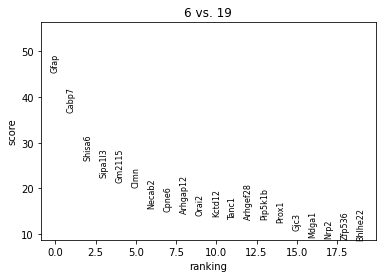

In [14]:
sc.tl.rank_genes_groups(adata, 'leiden_1_4', groups=['6'], reference='19', method='wilcoxon')
sc.pl.rank_genes_groups(adata, groups=['6'], n_genes=20)

In [ ]:
sc.tl.rank_genes_groups(adata, 'leiden_1_4', method='wilcoxon', key_added = "wilcoxon")

sc.pl.rank_genes_groups(adata, n_genes=5, sharey=False, key="wilcoxon",fontsize=25,save='original_leiden_3repl_1_4_deg_update.pdf')

# scRNAseq comparison

In [49]:
adata_sc=sc.read(r'C:/Users/sergio.salas\Documents\PhD\projects\Xenium_postprocessing\scRNAseq_ref\Yao_100kcells_subsample_ready.h5ad')

In [ ]:
adata_sc=adata_sc.layers['allgenes_lognorm']

In [52]:
res = pd.DataFrame(columns=adata_sc.var_names, index=adata_sc.obs['subclass_label'].cat.categories)                                                                                                 

for clust in adata_sc.obs.subclass_label.cat.categories: 
    res.loc[clust] = adata_sc[adata_sc.obs['subclass_label'].isin([clust]),:].X.mean(0)

In [50]:
res_sp = pd.DataFrame(columns=adata.var_names, index=adata.obs['leiden_1_4'].cat.categories)                                                                                                 

for clust in adata.obs.leiden_1_4.cat.categories: 
    res_sp.loc[clust] = adata[adata.obs['leiden_1_4'].isin([clust]),:].X.mean(0)

In [67]:
res_sp=res_sp.loc[:,res_sp.columns.isin(res_sc.columns)]
res_sc=res.loc[:,res.columns.isin(res_sp.columns)]
res_sc=res_sc.loc[:,res_sp.columns]

0.28456038163177766

In [88]:
cors=pd.DataFrame(index=res_sc.index,columns=res_sp.index)
for ind_sc in res_sc.index:
    for ind_sp in res_sp.index:
        cors.loc[ind_sc,ind_sp]=np.corrcoef(list(res_sc.loc[ind_sc,:]),list(res_sp.loc[ind_sp,:]))[0,1]

In [99]:
#plt.set_figure_params( dpi=150)
plt.rcParams['figure.facecolor'] = 'white'
plt.figure(figsize=(10,10))
sns.clustermap(cors.astype(float),figsize=(30,30))
plt.savefig('C:/Users/sergio.salas/Documents/PhD/JNotebooks/Xenium/FIGURES/correlation_140genes.pdf')

<Figure size 1500x1500 with 0 Axes>

# Saving and loading an anndata object

After finding the clusters and plotting them, one might want to calculate some spatial statistics. For this, a very useful tool is squidpy. You can visit that tutorial to learn a bit more about how to use it

In [39]:
annotation=pd.read_csv(r"C:\Users\sergio.salas\Documents\PhD\projects\Xenium_postprocessing\celltype_annotation\number_to_annotation_updated_cluster_3rep.csv",sep=';')

In [40]:
cluster14_initialannotation=dict(zip(annotation['cluster_1_4'],annotation['original_annotation']))
cluster14_Class=dict(zip(annotation['cluster_1_4'],annotation['Class']))
adata.obs['Class']=adata.obs['leiden_1_4'].astype(int).map(cluster14_Class)
adata.obs['initial_annotation']=adata.obs['leiden_1_4'].astype(str)+'_'+adata.obs['leiden_1_4'].astype(int).map(cluster14_initialannotation)
adata.obs['celltype_annotation']=adata.obs['leiden_1_4'].astype(int).map(cluster14_initialannotation)

In [41]:
adata.write(saving_path+'/adata_3replicates_updated_with_annotations.h5ad')

... storing 'initial_annotation' as categorical
... storing 'celltype_annotation' as categorical
... storing 'Class' as categorical


In [42]:
#adobs=adata.obs
#for rep in adata.obs['replicate'].unique():
#    adobssub=adobs[adobs['replicate']==rep]
#    adobssub.to_csv(r'D:\Xenium_data\prerelease_2_msbrain\xenium_prerelease_jun20_mBrain_replicates\output\3replicates_original\cluster_locations_annotations_rep'+str(rep)+'.csv')

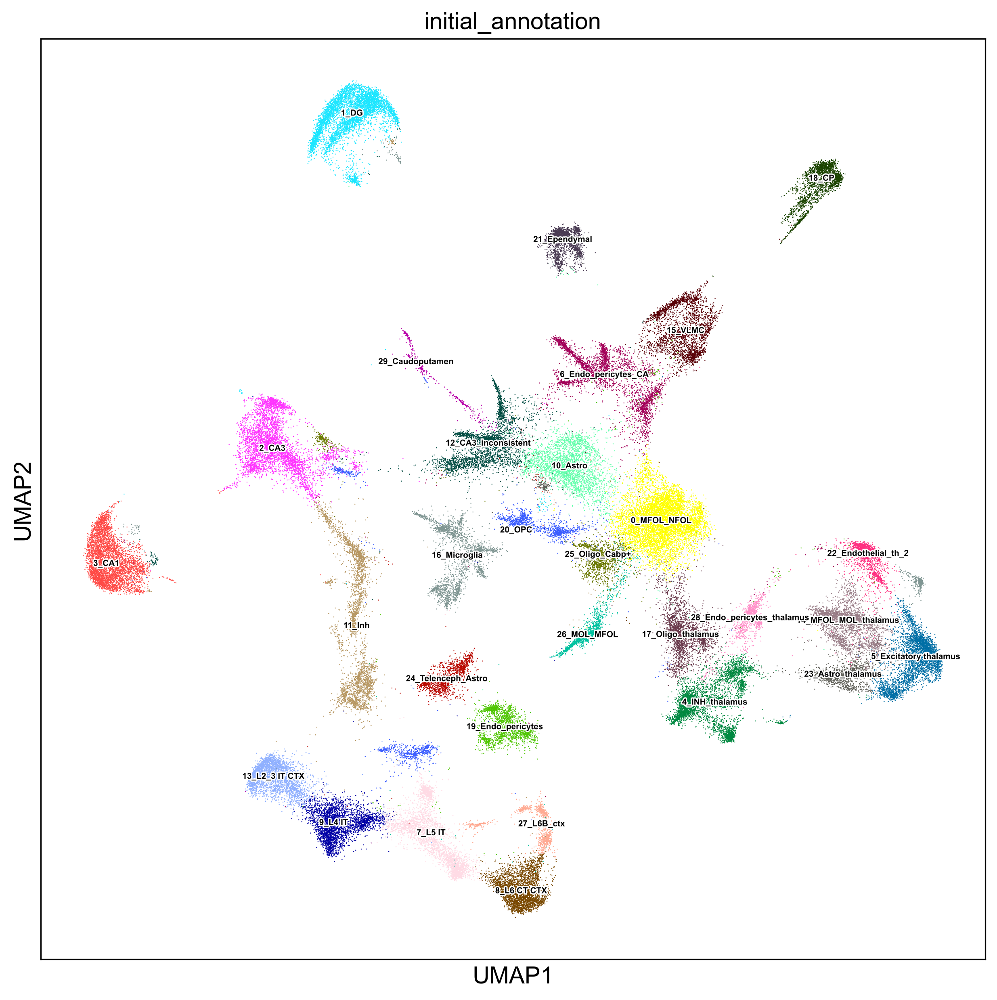

In [43]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,color=['initial_annotation'],size=1.5,legend_loc='on data',legend_fontsize=5,legend_fontoutline=1.5,save='umap_original_initial_annotation_3replicates_updated_ondata.pdf')

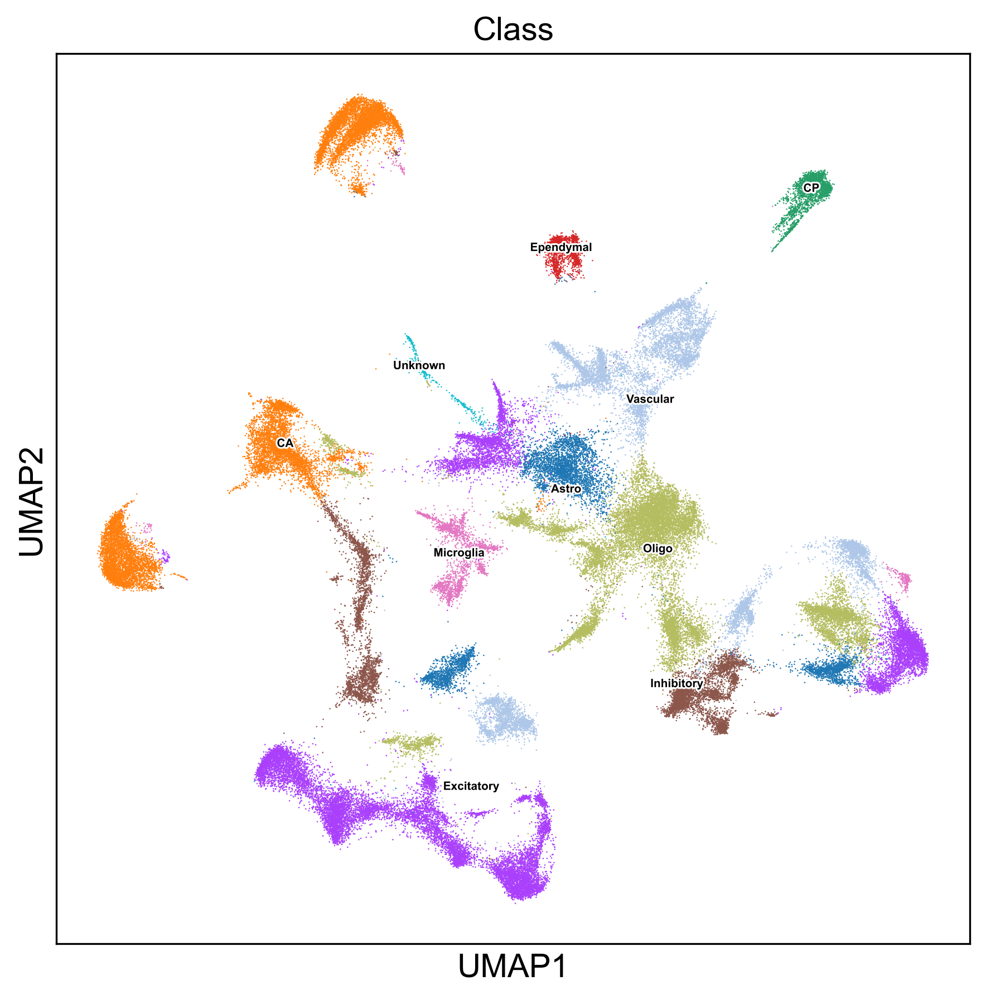

In [45]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(7,7))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,color=['Class'],size=1.5,legend_loc='on data',legend_fontsize=5,legend_fontoutline=1.5,save='umap_original_class_3replicates_updated_ondata.pdf')

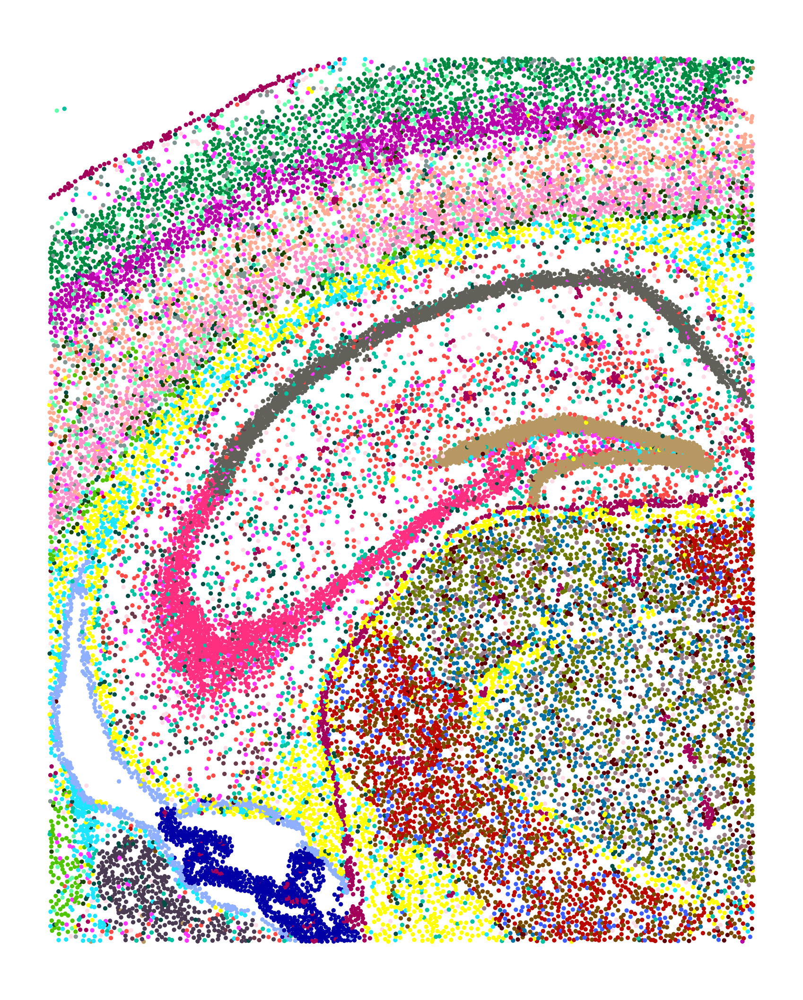

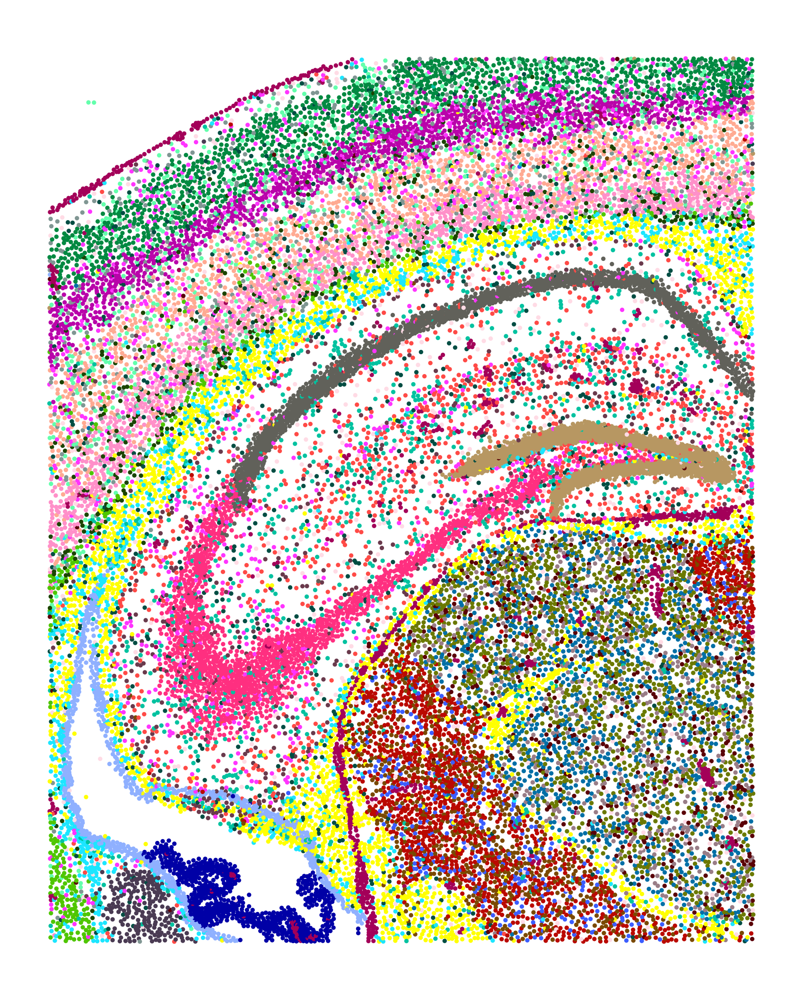

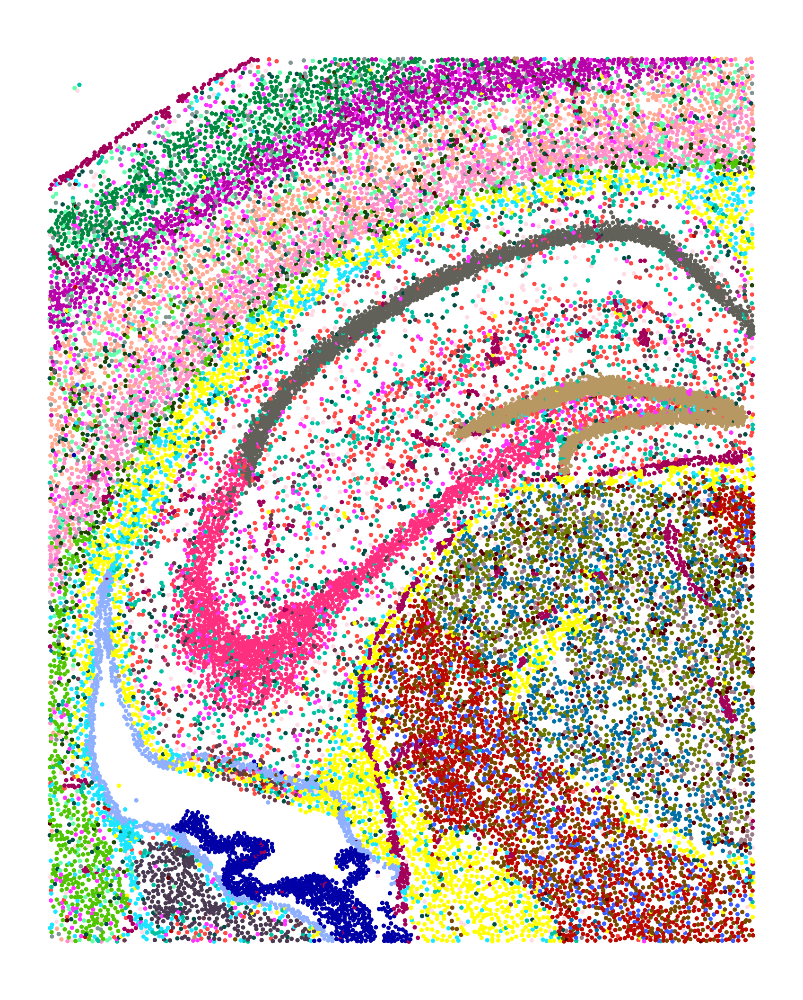

In [46]:
for s in adata.obs['replicate'].unique():
    adatasub=adata[adata.obs['replicate']==s]
    map_of_clusters(adatasub,key='initial_annotation',size=5,background='white',clusters='all',figuresize=(7,9))#,save='C:/Users/sergio.salas/Documents/PhD/JNotebooks/Xenium/figures',format='jpg')

In [27]:
adatasub.obs

,index,cell_id,x_centroid,y_centroid,transcript_counts,control_probe_counts,control_codeword_counts,total_counts,X,Y,replicate,leiden_2_2,leiden_1_8,leiden_1_4,leiden_1_0,leiden_0_8,leiden_0_6,initial_annotation
50173,0,0,780.800281,230.998976,97,0,0,97.0,780.800281,230.998976,3,17,19,16,15,12,13,16_CP
50174,1,1,752.809655,228.886954,45,0,0,45.0,752.809655,228.886954,3,25,25,24,21,21,15,24_Ependymal cells
50175,2,2,792.626171,226.960625,118,0,0,118.0,792.626171,226.960625,3,17,19,16,15,12,13,16_CP
50176,3,3,749.758277,233.763768,39,0,0,39.0,749.758277,233.763768,3,8,14,15,3,2,0,15_Astrocytes
50177,4,4,817.894667,229.959142,158,1,0,158.0,817.894667,229.959142,3,17,19,16,15,12,13,16_CP
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75708,25535,25535,2635.302476,3470.708987,113,0,0,113.0,2635.302476,3470.708987,3,0,0,1,0,0,0,1_Oligo_NFOL_MFOL_MOL
75709,25536,25536,2639.236270,3552.198754,190,0,0,190.0,2639.236270,3552.198754,3,15,6,8,10,10,11,8_Microglia
75710,25537,25537,2643.084421,3620.258314,195,0,0,195.0,2643.084421,3620.258314,3,23,24,25,25,3,4,25_Oligo_MFOL_NFOL
75711,25538,25538,2640.599865,3504.080872,82,0,0,82.0,2640.599865,3504.080872,3,0,0,1,0,0,0,1_Oligo_NFOL_MFOL_MOL


# Matching transcript with cell

In [73]:
transcript=pd.read_csv(r"D:\Xenium_data\prerelease_1_msbrain\xenium_prerelease_wehi (1)\xenium_prerelease_wehi\mBrain_ff\transcript_info_csv.csv")

In [74]:
cell_id_dictio=dictio=dict(zip(adata.obs['cell_id'],adata.obs['initial_annotation']))
transcript['cluster']=transcript['cell_id'].map(cell_id_dictio)

In [75]:
transcript['x_location']=transcript['x_location']*4.70588
transcript['y_location']=transcript['y_location']*4.70588

In [76]:
transcript

,object_id,cell_id,feature_name,x_location,y_location,z_location,qv,cluster
0,2,569,Sema5b,2404.892680,4971.881749,5.850120,21.676744,14_Region sp. Exc
1,3,-1,Acsbg1,2905.885606,5016.597492,6.539100,27.626547,NaN
2,4,608,Acsbg1,2336.336244,5022.243607,6.413838,40.000000,5_Endothelial
3,5,586,Acsbg1,2744.345451,4456.746948,6.692302,40.000000,8_Astrocytes
4,6,1194,Acsbg1,1545.929392,4495.497235,6.487611,40.000000,2_Astrocytes
...,...,...,...,...,...,...,...,...
14148811,15859738,55888,Mdga1,21724.638549,24551.757136,13.031317,19.799759,11_Cort Excitatory
14148812,15859739,55882,Adamts2,21683.617393,24650.465792,13.407087,40.000000,11_Cort Excitatory
14148813,15859741,56021,Adamts2,21908.001281,25090.672161,13.302668,40.000000,28_CD44+_Astro?
14148814,15859742,56021,Adamts2,21889.137291,25119.032146,13.167393,40.000000,28_CD44+_Astro?


In [ ]:
transcript.to_csv(r'D:\Xenium_data\prerelease_1_msbrain\xenium_prerelease_wehi (1)\xenium_prerelease_wehi\mBrain_ff\transcript_info_with_cluster.csv')

In [93]:
# Pseudotime for oligos 

In [3]:
saving_path=r'C:\Users\sergio.salas\Documents\PhD\projects\Xenium_postprocessing\formated_adata'
adata=sc.read(saving_path+'/adata_3replicates_updated_nuclear_only.h5ad')

In [4]:
adataoligo=adata[adata.obs['leiden_0_6'].isin(['1','5','14'])]

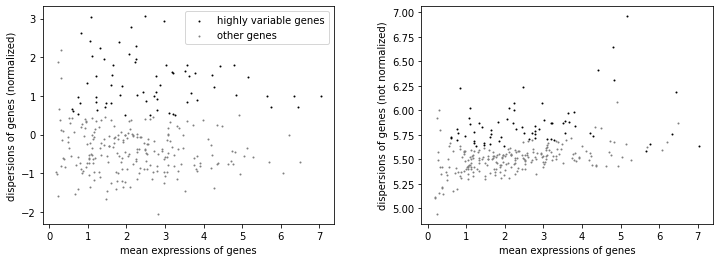

In [37]:
plt.rcParams['figure.facecolor'] = 'white'
sc.pp.highly_variable_genes(adataoligo, min_mean=0.5, max_mean=10, min_disp=0.5)
sc.pl.highly_variable_genes(adataoligo)
adataoligo.raw=adataoligo
adataoligo=adataoligo[:,adataoligo.var.highly_variable==True]

In [38]:
adataoligo

View of AnnData object with n_obs × n_vars = 16695 × 67
    obs: 'ind', 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'graph_clusters', 'kmeans2_clusters', 'kmeans3_clusters', 'kmeans4_clusters', 'kmeans5_clusters', 'kmeans6_clusters', 'kmeans7_clusters', 'kmeans8_clusters', 'kmeans9_clusters', 'kmeans10_clusters', 'replicate', 'leiden_2_2', 'leiden_1_8', 'leiden_1_4', 'leiden_1_0', 'leiden_0_8', 'leiden_0_6', 'oligo_0_5', 'dpt_pseudotime'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_1_4_colors', 'neighbors', 'pca', 'umap', 'draw_graph', 'paga', 'oligo_0_5_sizes', 'oligo_0_5_colors', 'iroot', 'diffmap_evals'
    obsm: 'X_pca', 'X_umap', 'X_draw_graph_fr', 'X_diffmap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [39]:
sc.pp.neighbors(adataoligo, n_neighbors=10, n_pcs=20)
sc.tl.draw_graph(adataoligo)

In [40]:
sc.tl.leiden(adataoligo, resolution=0.5,key_added='oligo_0_5')

In [41]:
sc.tl.paga(adataoligo, groups='oligo_0_5')

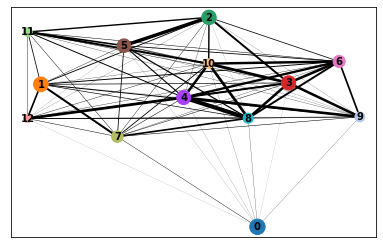

In [46]:
sc.pl.paga(adataoligo, color=['oligo_0_5'])

In [9]:
sc.tl.draw_graph(adataoligo, init_pos='paga')

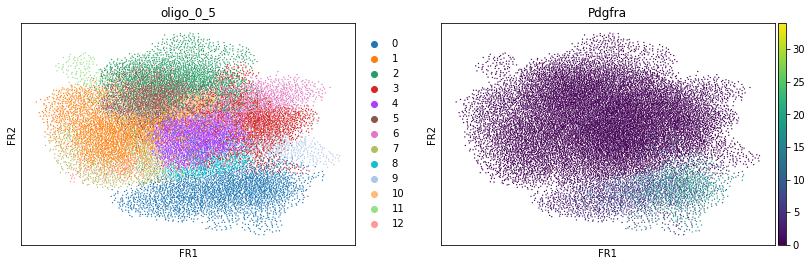

In [11]:
sc.pl.draw_graph(adataoligo, color=['oligo_0_5','Pdgfra'])

In [43]:
adataoligo.uns['iroot'] = np.flatnonzero(adataoligo.obs['oligo_0_5']  == '0')[70]

In [44]:
sc.tl.dpt(adataoligo)

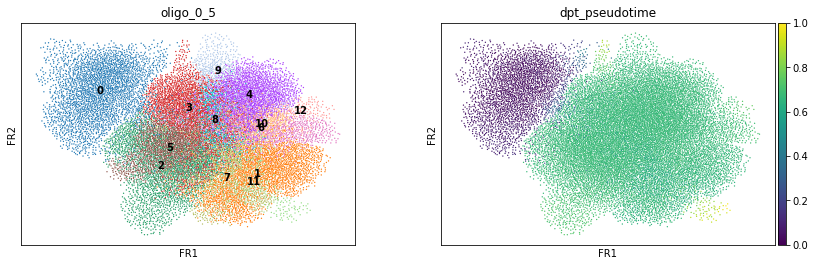

In [45]:
sc.pl.draw_graph(adataoligo, color=['oligo_0_5', 'dpt_pseudotime'], legend_loc='on data')

In [54]:
sc.tl.umap(adataoligo)

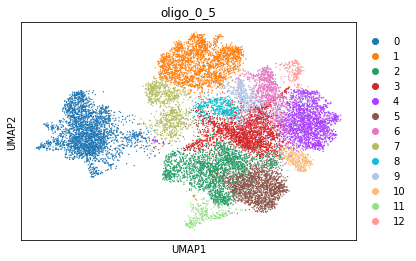

In [60]:
sc.pl.umap(adataoligo, color='oligo_0_5')

In [62]:
adataoligo.obs['X']=adataoligo.obs['x_centroid']
adataoligo.obs['Y']=adataoligo.obs['y_centroid']

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


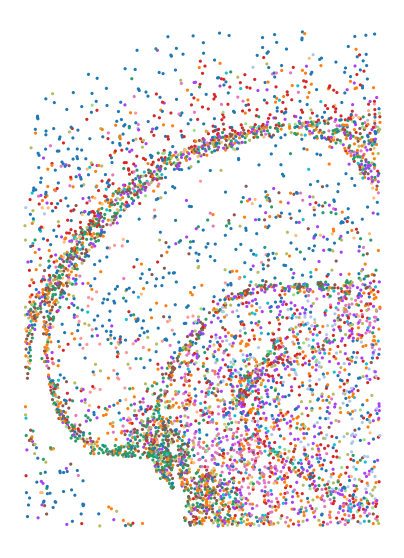

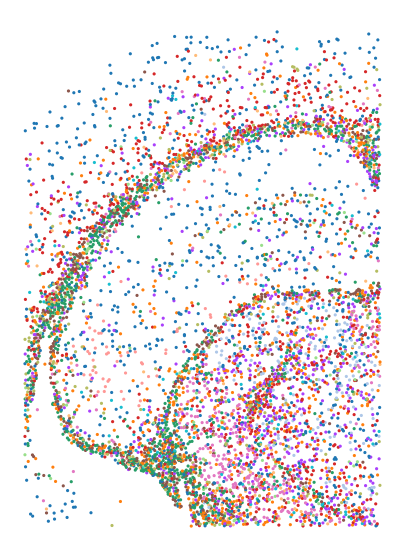

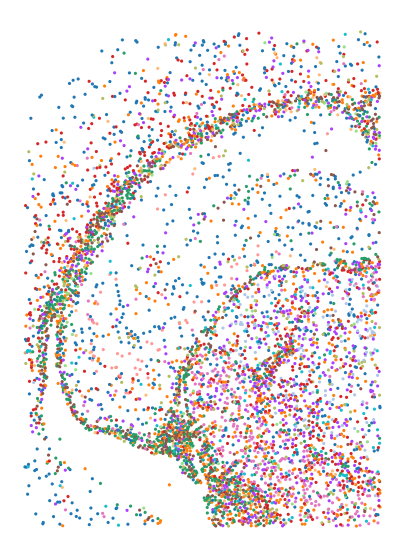

In [65]:
for s in adata.obs['replicate'].unique():
    adatasub=adataoligo[adataoligo.obs['replicate']==s]
    map_of_clusters(adatasub,key='oligo_0_5',size=10,background='white',clusters='all',figuresize=(7,10))#,save='C:/Users/sergio.salas/Documents/PhD/JNotebooks/Xenium/figures',format='jpg')

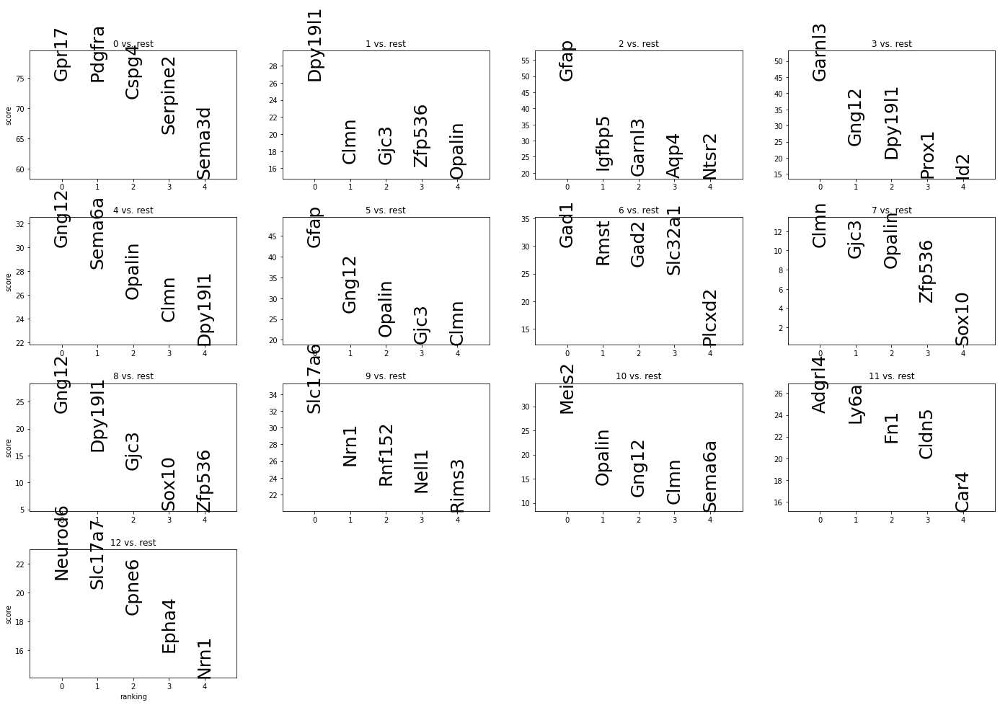

In [66]:
sc.tl.rank_genes_groups(adataoligo, 'oligo_0_5', method='wilcoxon', key_added = "wilcoxon")

sc.pl.rank_genes_groups(adataoligo, n_genes=5, sharey=False, key="wilcoxon",fontsize=25)

In [ ]:
sc.pl.draw_graph(adataoligo, color=['dpt_pseudotime'],vmax=0.8)

In [48]:
adatasub

View of AnnData object with n_obs × n_vars = 5609 × 284
    obs: 'ind', 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'graph_clusters', 'kmeans2_clusters', 'kmeans3_clusters', 'kmeans4_clusters', 'kmeans5_clusters', 'kmeans6_clusters', 'kmeans7_clusters', 'kmeans8_clusters', 'kmeans9_clusters', 'kmeans10_clusters', 'replicate', 'leiden_2_2', 'leiden_1_8', 'leiden_1_4', 'leiden_1_0', 'leiden_0_8', 'leiden_0_6', 'oligo_0_5', 'dpt_pseudotime'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_1_4_colors', 'neighbors', 'pca', 'umap', 'draw_graph', 'paga', 'oligo_0_5_sizes', 'oligo_0_5_colors', 'iroot', 'diffmap_evals'
    obsm: 'X_pca', 'X_umap', 'X_draw_graph_fr', 'X_diffmap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

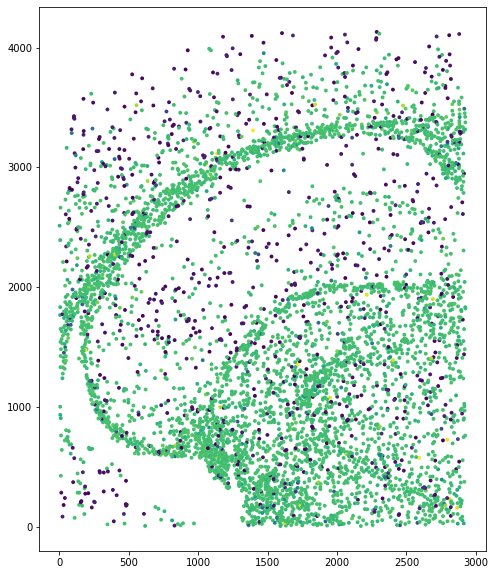

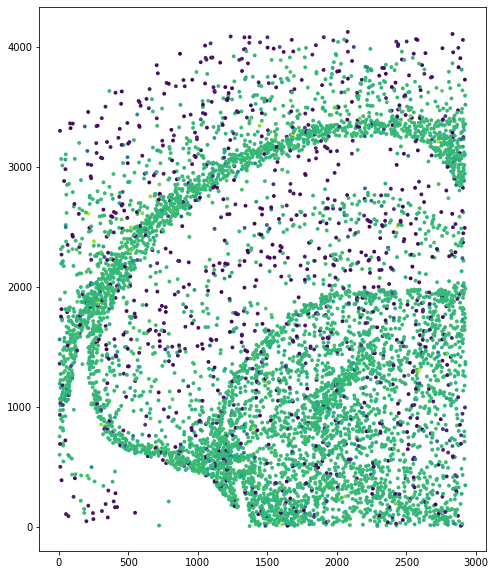

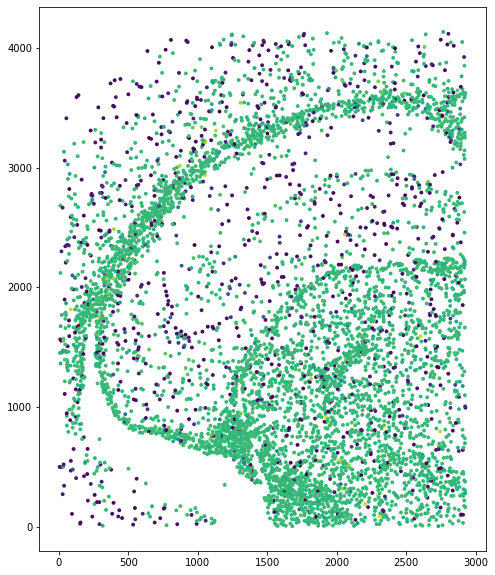

In [49]:
for s in adataoligo.obs['replicate'].unique():
    adatasub=adataoligo[adataoligo.obs['replicate']==s]
    plt.figure(figsize=(8,10))
    plt.scatter(x=adatasub.obs.x_centroid,y=adatasub.obs.y_centroid,c=adatasub.obs['dpt_pseudotime'],s=15,linewidths=0, edgecolors=None)